# 키워드 분석 및 시각화


### 배경
네이버 카페 "맘스홀릭베이비"의 "아기 건강 질문방" 게시판의 1년동안 올라온 게시글  
-> 스크래핑  
-> aws glue 크롤러를 통한 데이터 카탈로그 테이블  
-> aws glue etl job을 통한 정제 (날짜 형식 통일, 텍스트 정리 (이모지, 특수문자, 중복 공백 제거), 제목 + 내용 컬럼 통합)  
-> local 환경에서 키워드 분석 및 시각화  

<br>

### 사유
aws athena 환경에서 sql을 통해 "제목" + "내용" 데이터(비정형)를 분석하기 어려움.

<br>

### 작업내용
pandas, 한국어 형태소 라이브러리를 활용하여 데이터를 정제, 저장, 시각화
  1. 정제
      - 토큰 추출
      - 불용어 제거
      - 특정 키워드 포함 여부에 따른 그룹화
  2. 저장
  3. 시각화

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [2]:
!pip install kiwipiepy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.7/34.7 MB 36.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 68.9 MB/s eta 0:00:00
  Created wheel for kiwipiepy_model: filename=kiwipiepy_model-0.20.0-py3-none-any.whl size=34818026 sha256=f922bd0924ebd4565fac13feeb12ba5df005fc98876d060312ddd2288cb87cc1
  Stored in directory: /root/.cache/pip/wheels/ca/c8/52/3a539d6e9065b191fe1c215e0203dcc3e00601c0e3d3d39824
Successfully built kiwipiepy_model


In [4]:
import os
import json
import re
from kiwipiepy import Kiwi
import pandas as pd
import pyarrow.parquet as pq
from collections import Counter
import math
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import matplotlib.font_manager as font_manager
from matplotlib import rc
import seaborn as sns
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

In [5]:
# 한글 폰트 설정
font_path = '/content/drive/MyDrive/babycareai/NanumGothic-Regular.ttf'
font_manager.fontManager.addfont(font_path)
font_name = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font_name)

In [6]:
# Drive에서 파일 로드
file_path = '/content/drive/MyDrive/babycareai/part-00000-0d16091a-7fa1-464f-9f1c-b2c0bf27fe0a-c000.snappy.parquet'

In [7]:
# Parquet 파일을 pandas DataFrame으로 읽기
table = pq.read_table(file_path)
df = table.to_pandas()

In [9]:
df.head()

,url,post_id,raw_date,author,question_text
0,https://cafe.naver.com/imsanbu/70682807,70682807,2024.04.27. 14:11,HSSSH,11개월 아기 본가에 와서 40cm정도 되는 높이에서 떨어졌는데 기와집이라 마당있는...
1,https://cafe.naver.com/imsanbu/70682817,70682817,2024.04.27. 14:12,꿀꿀이1005,7개월이 변비 이유식량이 늘다보니 토끼똥을 힘을 주는데 아파하고 짜증내면서 응가를 ...
2,https://cafe.naver.com/imsanbu/70682839,70682839,2024.04.27. 14:15,진짜나짱,발목이예요 긁어대면 저러던데 손독인건가요 아빠랑 놀다가 어디에 부딪힌건지 뭐가 피부...
3,https://cafe.naver.com/imsanbu/70682880,70682880,2024.04.27. 14:23,쑥달래,곧 9개월 아기 이유식은 잘 먹는데 분유를 너무 안먹는데 괜찮나요 둘째인데도 애바애...
4,https://cafe.naver.com/imsanbu/70682910,70682910,2024.04.27. 14:25,jhjh123,아기 소변에 점액질 안녕하세요 25일된 신생아이고 3시간 마다 90씩 먹고 잘 우는...


## 토큰 추출 및 불용어 제거

In [11]:
# 1. 불용어 리스트 별도 파일로 분리
def save_stopwords_to_file():
    stopwords = ['요','개월','때','오늘','좀','일','지금','혹시','정도','계속','걱정',
                '어제','더','것','이','거','번','또','시간','건','남아','며칠','기도',
                '갑자기','한번','아침','다시','도','먹이','하루','사진','후','다리',
                '전','안','뭘','이유식','뭐','집','그냥','애기','왜','저','눈','목',
                '돌','시작','코','해','추천','조금','저녁','때문','원래','이제',
                '다른','유산균','밥','접종','손','처음','어린이집','소리','가요',
                '달','밤','바로','말','맘','물','자주','걸','뒤','수','개','배','구'
                '경우','부분','생각','쪽','살','주','기저귀','날','시','새벽','몸',
                '상태','컨디션','아시','입','응','그','요즘','경험','일차','내일',
                '여','잠','거의','양제','하나','자꾸','고민','발', '귀','정상','증',
                '곳','비','보고','저희','자고','살짝','에','이상','월','하나요','평소',
                '모기','비타민','발라','언제','차','글','우유','며칠','이번','머리',
                '기도','건가','일단','데','신분','선생님','소아','진짜','현재','문제',
                '아기','아이','애','신생아','엄마','영양제','연고', '일주일'
                ]
    # 불용어 리스트를 텍스트 파일로 저장
    stopwords_file_path = '/content/drive/MyDrive/babycareai/stopwords.txt'
    with open(stopwords_file_path, 'w', encoding='utf-8') as f:
        for word in stopwords:
            f.write(word + '\n')
    return stopwords_file_path

In [14]:
def load_stopwords(file_path):
    # 불용어 리스트를 파일에서 불러오기
    try:
        with open(file_path, 'r', encoding='utf-8') as f:
            stopwords = [line.strip() for line in f.readlines()]
        return stopwords
    except FileNotFoundError:
        # 파일이 없으면 생성 후 불러오기
        file_path = save_stopwords_to_file()
        return load_stopwords(file_path)

In [16]:
# 불용어 파일 경로
stopwords_file_path = '/content/drive/MyDrive/babycareai/stopwords.txt'
# 불용어 리스트 불러오기
FILTER_WORDS = load_stopwords(stopwords_file_path)

In [17]:
TERM_POSES = ["NNP", "NNG", "XR"]

In [18]:
# Kiwi를 사용하여 각 질문 텍스트를 형태소 분석하고, 조건에 맞는 토큰만 추출
kiwi = Kiwi()
def extract_tokens(text):
    # 형태소 분석: 품사 정보를 포함한 토큰 리스트 획득
    analyzed = kiwi.analyze(text)
    tokens = []
    for sent in analyzed:
        for word_info in sent[0]:
            token, pos = word_info[0], word_info[1]
            # 지정한 품사만 선택하고, 필터 단어 목록에 없는 단어만 사용
            if pos in TERM_POSES and token not in FILTER_WORDS:
                tokens.append(token)
    return tokens

In [19]:
# 각 행에 대해 토큰 추출 (토큰 리스트 컬럼 추가)
df['tokens'] = df['question_text'].apply(lambda x: extract_tokens(x))

# 2. 특정 키워드 포함 여부에 따른 그룹별 분석

In [20]:
# 2. 특정 키워드 포함 여부에 따른 그룹별 분석
# 키워드 포함 여부를 판단하는 함수
def has_keywords(text, keywords):
    return any(keyword in text for keyword in keywords)

In [21]:
# 키워드 그룹 정의 - 22개의 그룹 추가
keyword_groups = {
    'hospital': ['병원', '소아과'],
    'symptom': ['증상'],
    'skin': ['피부'],
    'fever': ['열'],
    'cough': ['기침'],
    'runny_nose': ['콧물'],
    'stool': ['변', '똥'],
    'hand_foot': ['수족'],
    'diarrhea': ['설사'],
    'allergy': ['알러지', '알레르기'],
    'atopy': ['아토피'],
    'urticaria': ['두드러기'],
    'vomit': ['토', '구토'],
    'blood': ['피'],
    'heat_rash': ['땀띠'],
    'seborrheic': ['태열'],
    'flu': ['독감'],
    'pneumonia': ['폐렴'],
    'phlegm': ['가래'],
    'rash': ['발진'],
    'blister': ['수포'],
    'otitis': ['중이염']
}

In [22]:
# 각 키워드 그룹에 대해 컬럼 생성
for group_name, keywords in keyword_groups.items():
    df[f'has_{group_name}'] = df['question_text'].apply(lambda x: has_keywords(x, keywords))

In [23]:
# 토큰화된 텍스트를 공백을 구분자로 하여 문서별 문자열로 변환
df['processed_text'] = df['tokens'].apply(lambda tokens: ' '.join(tokens))

In [31]:
# 파일 이름에 사용할 수 있는 안전한 이름으로 변환하는 함수
def sanitize_filename(name):
    # 파일명에 사용할 수 없는 문자 제거 또는 대체
    return name.replace('/', '_').replace('\\', '_').replace(':', '_').replace('*', '_').replace('?', '_').replace('"', '_').replace('<', '_').replace('>', '_').replace('|', '_')

In [24]:
# 그룹별 데이터 개수 확인 및 비율 계산
group_counts = {}
total_count = len(df)
for group_name in keyword_groups.keys():
    count = df[f'has_{group_name}'].sum()
    percentage = (count / total_count) * 100
    group_counts[group_name] = (count, percentage)

In [32]:
# 번역된 그룹명 매핑
group_name_mapping = {
    'hospital': '병원_소아과',
    'symptom': '증상',
    'skin': '피부',
    'fever': '열',
    'cough': '기침',
    'runny_nose': '콧물',
    'stool': '변_똥',
    'hand_foot': '수족',
    'diarrhea': '설사',
    'allergy': '알러지_알레르기',
    'atopy': '아토피',
    'urticaria': '두드러기',
    'vomit': '토_구토',
    'blood': '피',
    'heat_rash': '땀띠',
    'seborrheic': '태열',
    'flu': '독감',
    'pneumonia': '폐렴',
    'phlegm': '가래',
    'rash': '발진',
    'blister': '수포',
    'otitis': '중이염'
}

# 그룹명 표시용 매핑 (슬래시 포함)
display_name_mapping = {
    'hospital': '병원/소아과',
    'symptom': '증상',
    'skin': '피부',
    'fever': '열',
    'cough': '기침',
    'runny_nose': '콧물',
    'stool': '변/똥',
    'hand_foot': '수족',
    'diarrhea': '설사',
    'allergy': '알러지/알레르기',
    'atopy': '아토피',
    'urticaria': '두드러기',
    'vomit': '토/구토',
    'blood': '피',
    'heat_rash': '땀띠',
    'seborrheic': '태열',
    'flu': '독감',
    'pneumonia': '폐렴',
    'phlegm': '가래',
    'rash': '발진',
    'blister': '수포',
    'otitis': '중이염'
}


<ipython-input-33-2e16ddbb4f5e>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='그룹', y='문서 수', data=group_count_df, palette='viridis')


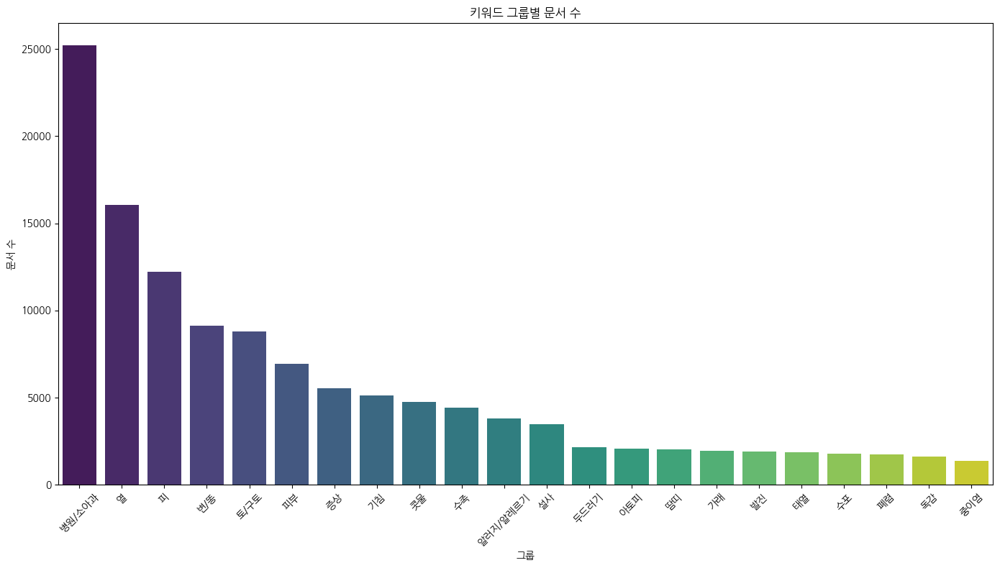

<ipython-input-33-2e16ddbb4f5e>:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='그룹', y='비율(%)', data=group_count_df, palette='viridis')


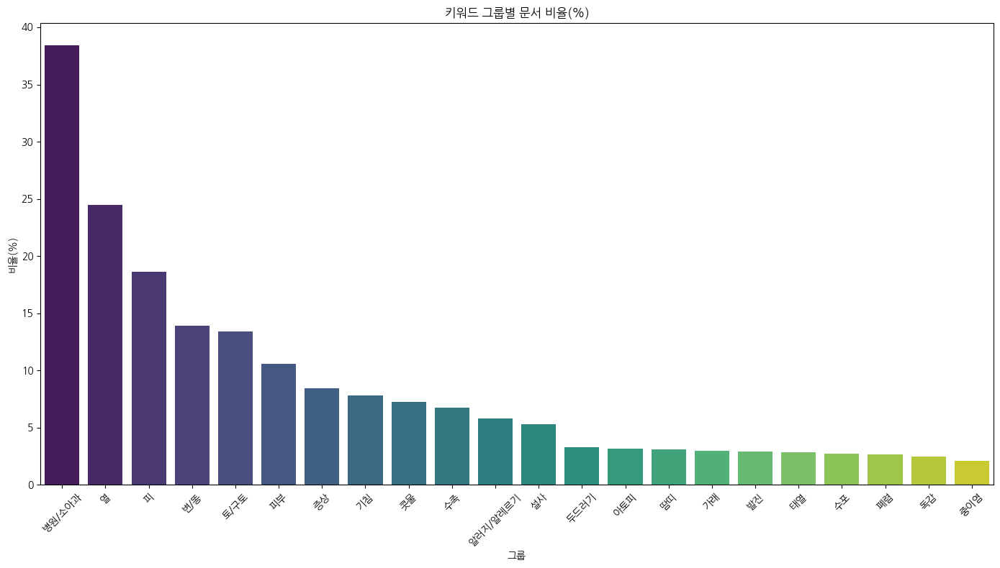

In [33]:
# 그룹별 데이터 개수 시각화
group_count_df = pd.DataFrame([
    {'그룹': display_name_mapping.get(group_name, group_name), '문서 수': count, '비율(%)': percentage}
    for group_name, (count, percentage) in group_counts.items()
])
group_count_df = group_count_df.sort_values(by='문서 수', ascending=False)

plt.figure(figsize=(14, 8))
sns.barplot(x='그룹', y='문서 수', data=group_count_df, palette='viridis')
plt.title('키워드 그룹별 문서 수')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

plt.figure(figsize=(14, 8))
sns.barplot(x='그룹', y='비율(%)', data=group_count_df, palette='viridis')
plt.title('키워드 그룹별 문서 비율(%)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [34]:
# 전체 데이터 분석 함수
def analyze_and_visualize(data, title_prefix="전체", save_plots=False, output_dir=None):
    """
    데이터를 분석하고 시각화하는 함수

    Parameters:
    - data: 분석할 데이터프레임
    - title_prefix: 시각화 제목 접두사
    - save_plots: 그래프를 저장할지 여부
    - output_dir: 그래프 저장 디렉토리

    Returns:
    - token_freq: 토큰 빈도수 사전
    - tfidf_dict: TF-IDF 점수 사전
    """
    # 데이터가 비어있는 경우 처리
    if len(data) == 0:
        print(f"{title_prefix} 그룹에 데이터가 없습니다.")
        return {}, {}

    # 저장 디렉토리 생성
    if save_plots and output_dir and not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # 파일명용 안전한 제목
    safe_title = sanitize_filename(title_prefix)

    # 토큰 빈도수 집계
    all_tokens = [token for tokens in data['tokens'] for token in tokens]
    token_freq = Counter(all_tokens)

    # 빈도수가 높은 단어 추출
    top_tokens = token_freq.most_common(30)
    df_top_tokens = pd.DataFrame(top_tokens, columns=['단어', '빈도수'])

    # 1. 막대 그래프 (빈도수)
    plt.figure(figsize=(12, 6))
    sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')
    plt.title(f'{title_prefix} - 상위 단어 빈도수')
    plt.xticks(rotation=45)
    plt.tight_layout()

    if save_plots and output_dir:
        plt.savefig(os.path.join(output_dir, f'{safe_title}_frequency_bar.png'), dpi=300)

    plt.show()

    # 2. 워드클라우드 (빈도수)
    wc = WordCloud(font_path=font_path, background_color='white', width=800, height=400)
    wc.generate_from_frequencies(token_freq)
    plt.figure(figsize=(14, 7))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'{title_prefix} - 빈도수 기반 워드클라우드', fontsize=20)

    if save_plots and output_dir:
        plt.savefig(os.path.join(output_dir, f'{safe_title}_frequency_wordcloud.png'), dpi=300)

    plt.show()

    # 3. TF-IDF 분석
    if len(data) > 1:  # 데이터가 1개 이상일 때만 TF-IDF 계산
        vectorizer = TfidfVectorizer(token_pattern=r'(?u)\b\w+\b')
        tfidf_matrix = vectorizer.fit_transform(data['processed_text'])
        feature_names = vectorizer.get_feature_names_out()

        # 각 단어의 평균 tf-idf 점수 계산
        avg_tfidf_scores = np.asarray(tfidf_matrix.mean(axis=0)).ravel()
        tfidf_dict = dict(zip(feature_names, avg_tfidf_scores))

        # tf-idf 점수가 높은 단어 추출
        top_tfidf = sorted(tfidf_dict.items(), key=lambda x: x[1], reverse=True)[:30]
        df_top_tfidf = pd.DataFrame(top_tfidf, columns=['단어', 'TF-IDF'])

        # 4. 막대 그래프 (TF-IDF)
        plt.figure(figsize=(12, 6))
        sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')
        plt.xlabel('단어')
        plt.ylabel('평균 TF-IDF 점수')
        plt.title(f'{title_prefix} - TF-IDF 상위 단어')
        plt.xticks(rotation=45)
        plt.tight_layout()

        if save_plots and output_dir:
            plt.savefig(os.path.join(output_dir, f'{safe_title}_tfidf_bar.png'), dpi=300)

        plt.show()

        # 5. 워드클라우드 (TF-IDF)
        wc_tfidf = WordCloud(font_path=font_path, background_color='white', width=800, height=400)
        wc_tfidf.generate_from_frequencies(tfidf_dict)
        plt.figure(figsize=(14, 7))
        plt.imshow(wc_tfidf, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'{title_prefix} - TF-IDF 기반 워드클라우드', fontsize=20)

        if save_plots and output_dir:
            plt.savefig(os.path.join(output_dir, f'{safe_title}_tfidf_wordcloud.png'), dpi=300)

        plt.show()

        return token_freq, tfidf_dict

    return token_freq, {}

In [35]:
# 결과 저장 디렉토리 생성
output_dir = '/content/drive/MyDrive/babycareai/analysis_results'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)


===== 전체 데이터 분석 =====


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


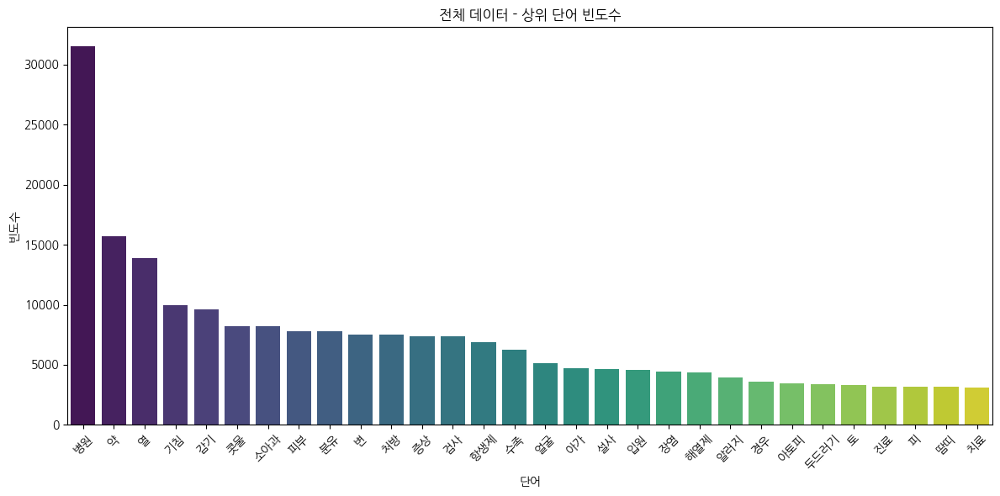

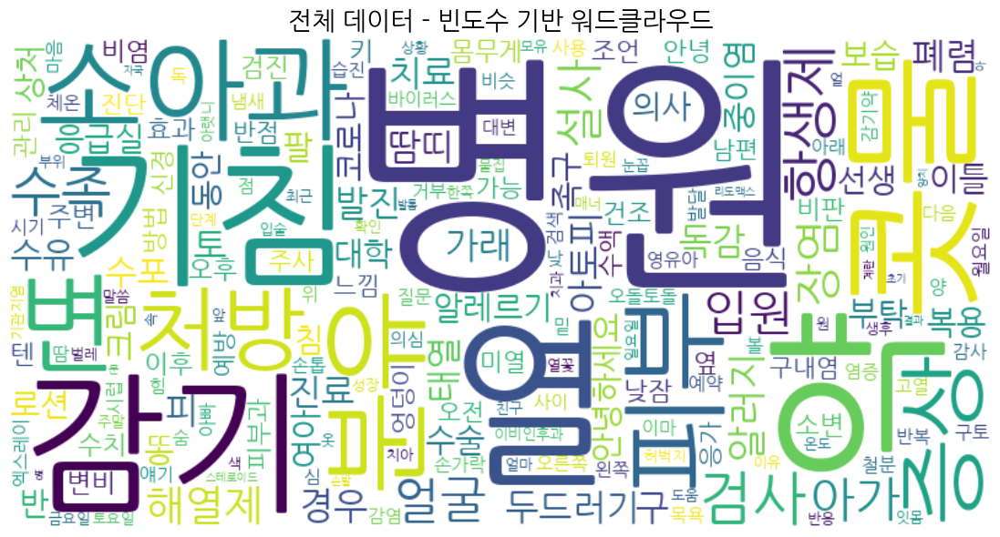

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


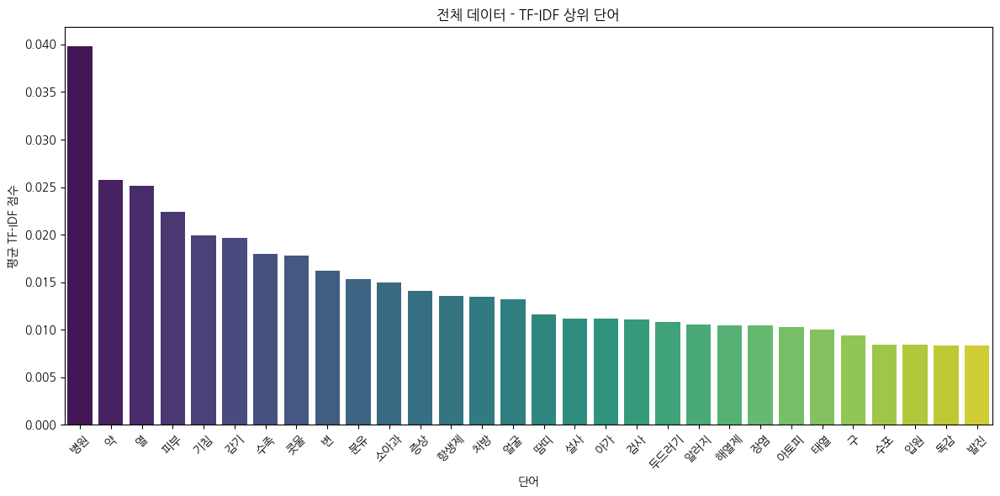

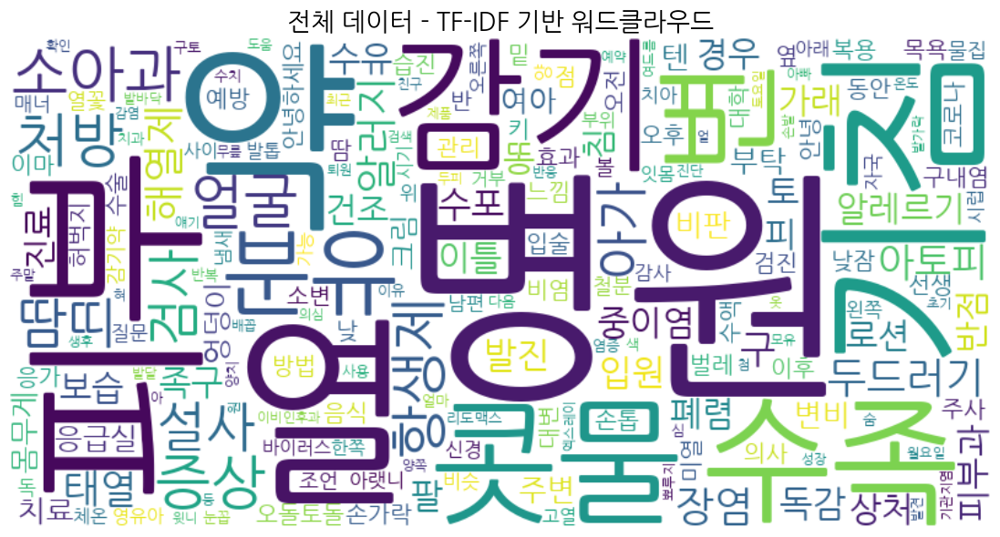

In [36]:
# 전체 데이터 분석
print("\n===== 전체 데이터 분석 =====")
all_token_freq, all_tfidf_dict = analyze_and_visualize(df, "전체 데이터", True, output_dir)

In [37]:
# 각 키워드 그룹별 분석 결과 저장
group_results = {}


===== hospital 키워드 데이터 분석 =====
hospital 키워드 포함 문서 수: 25211


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


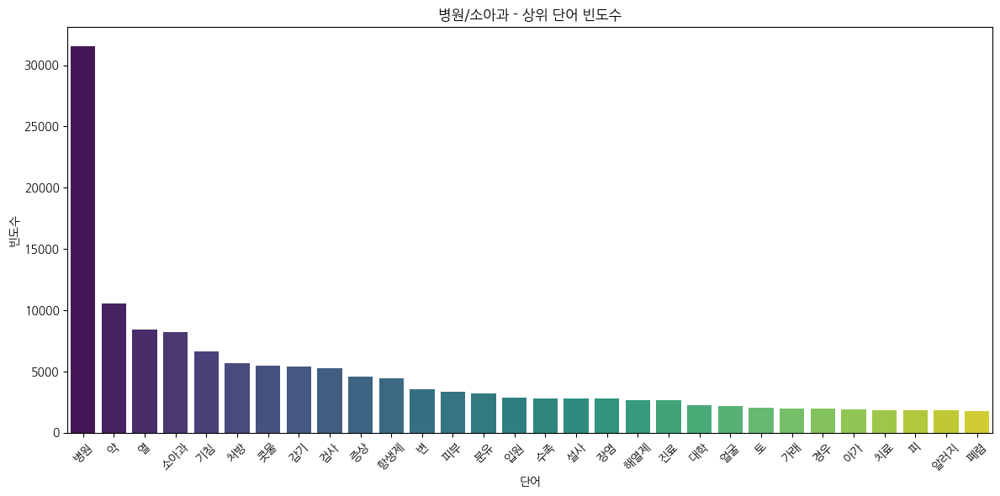

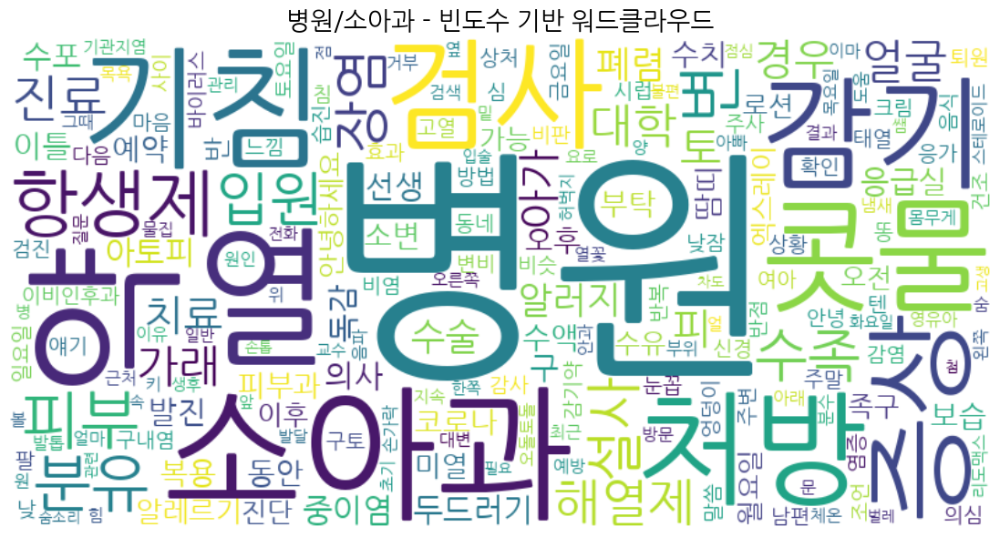

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


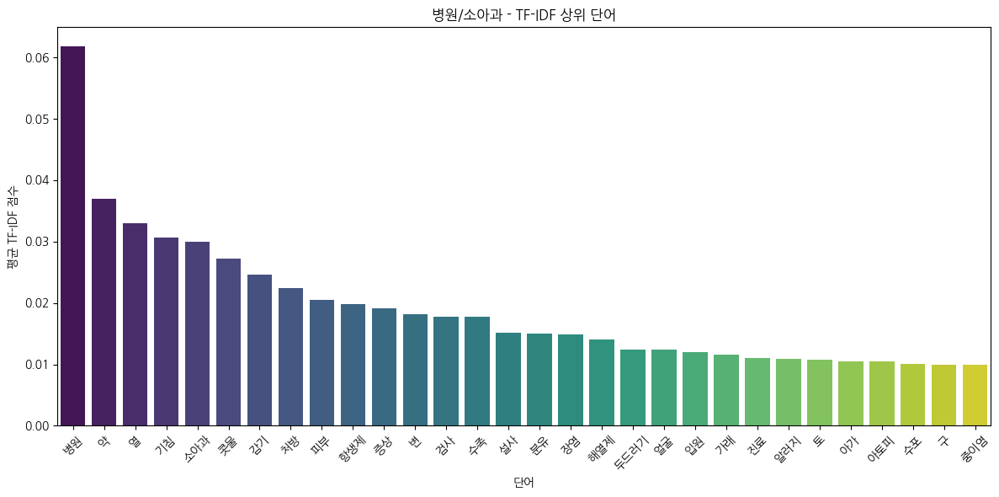

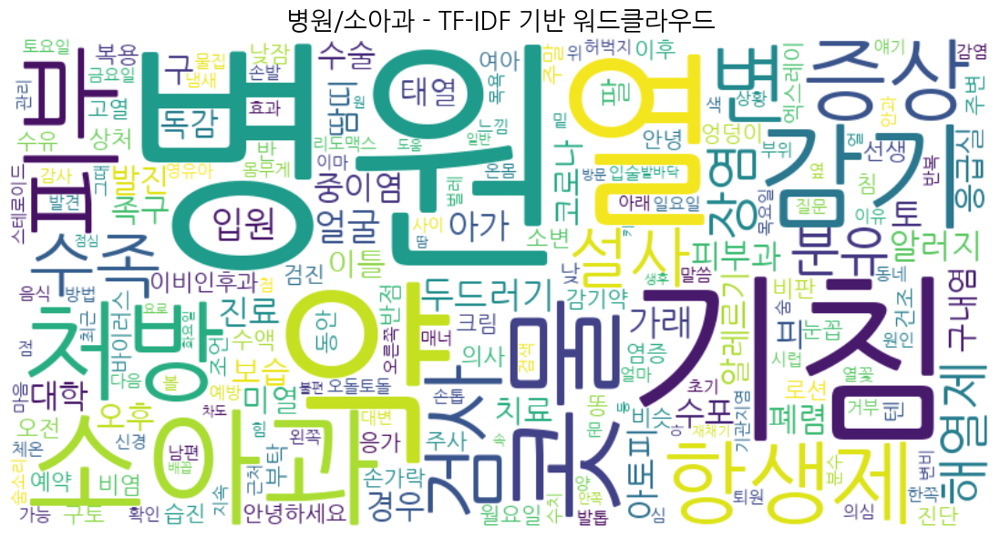


===== symptom 키워드 데이터 분석 =====
symptom 키워드 포함 문서 수: 5559


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


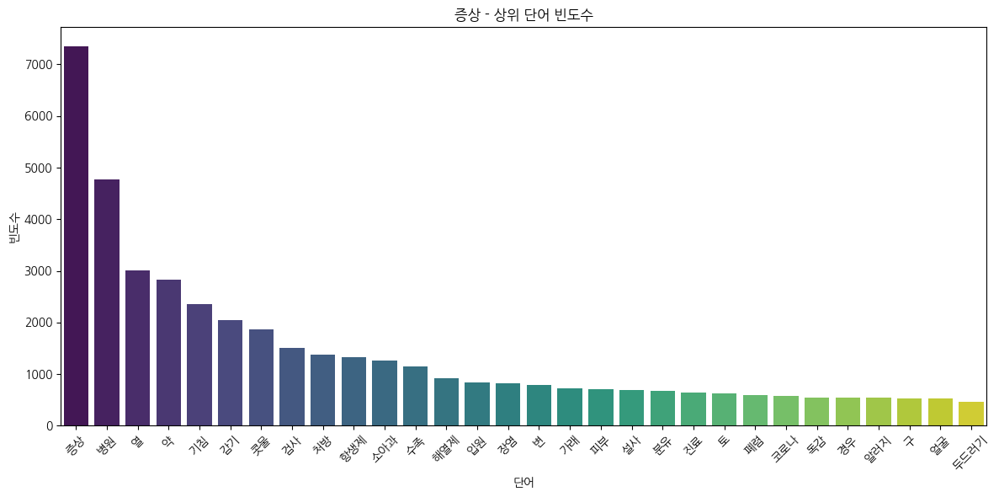

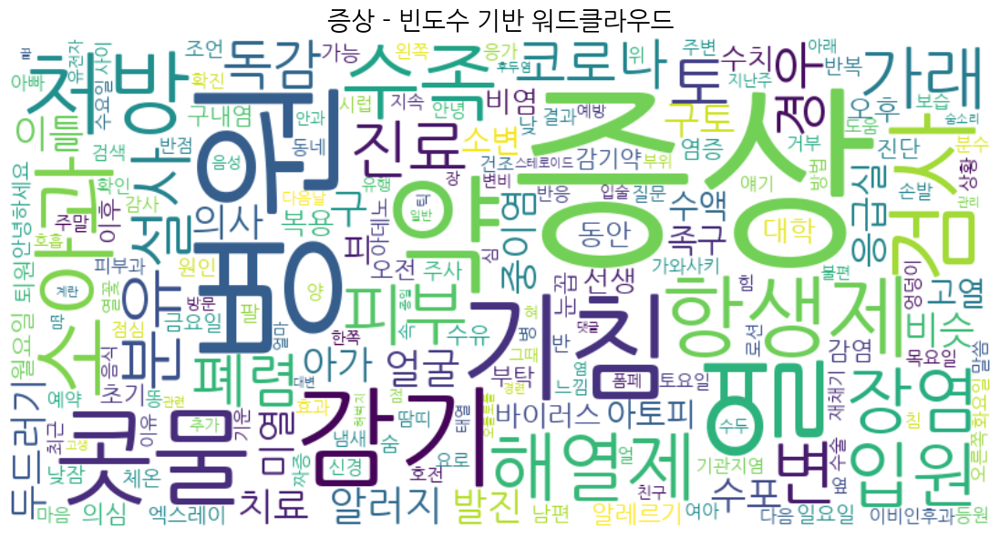

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


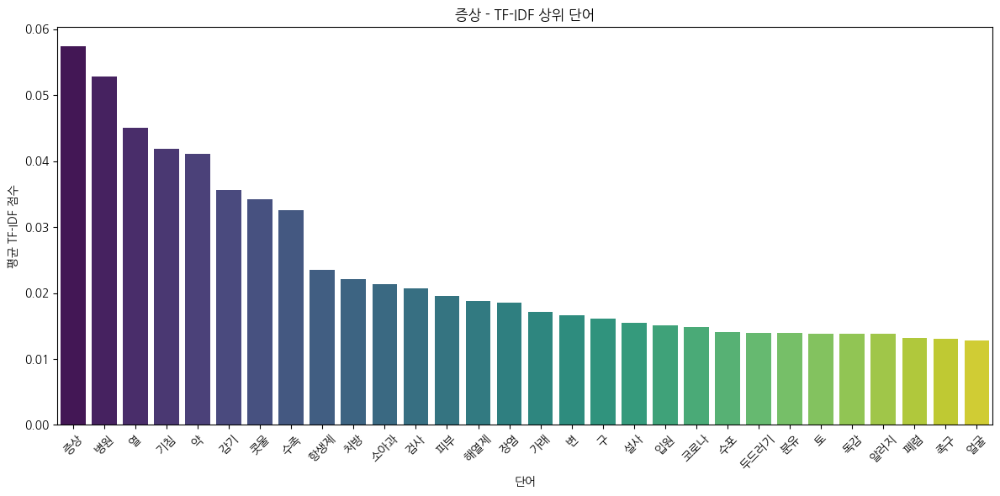

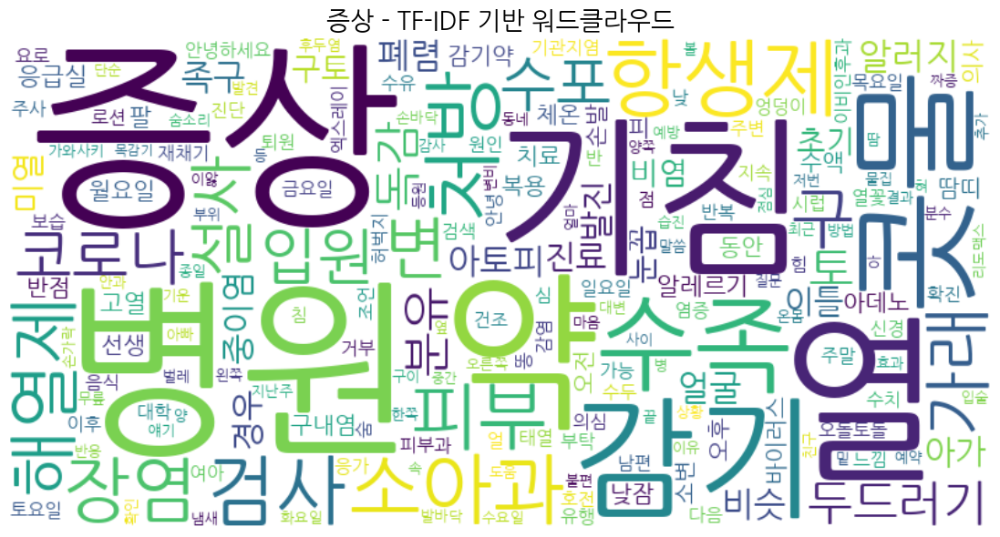


===== skin 키워드 데이터 분석 =====
skin 키워드 포함 문서 수: 6952


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


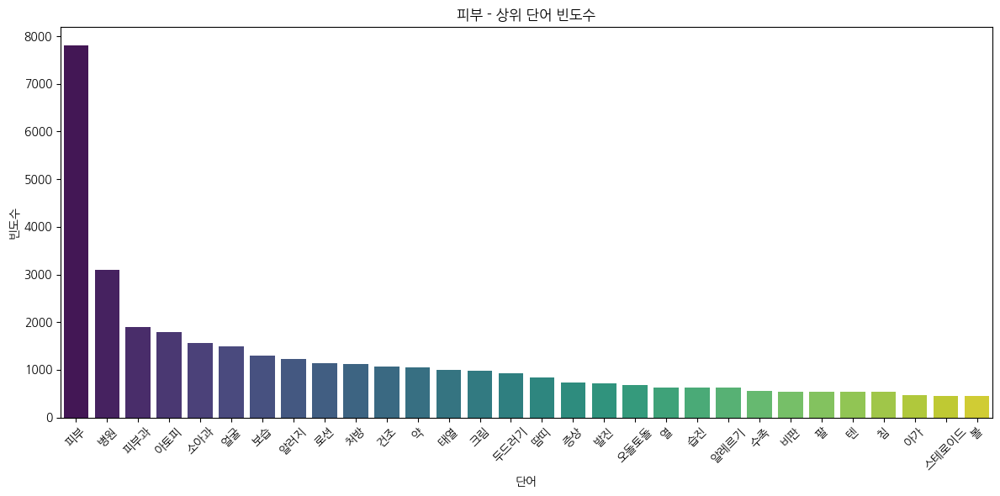

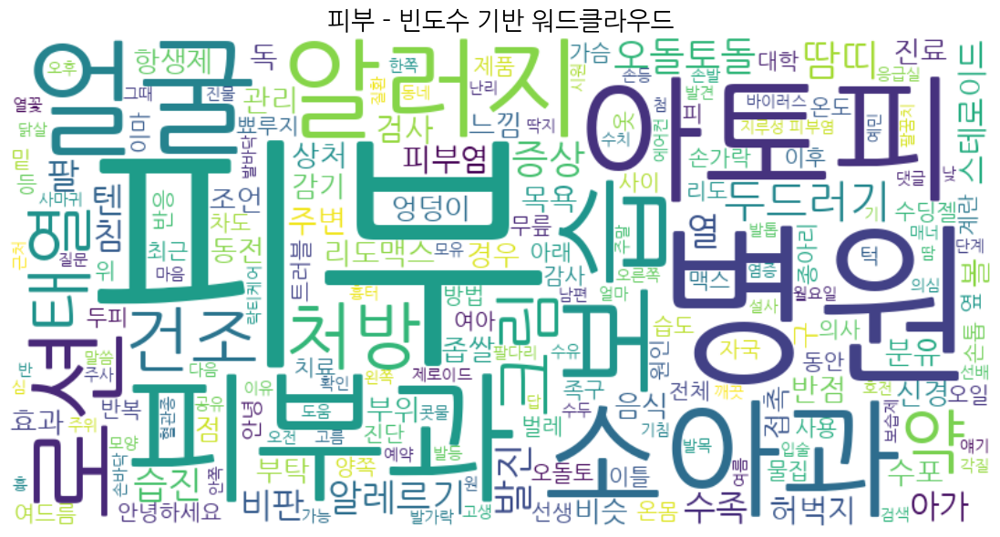

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


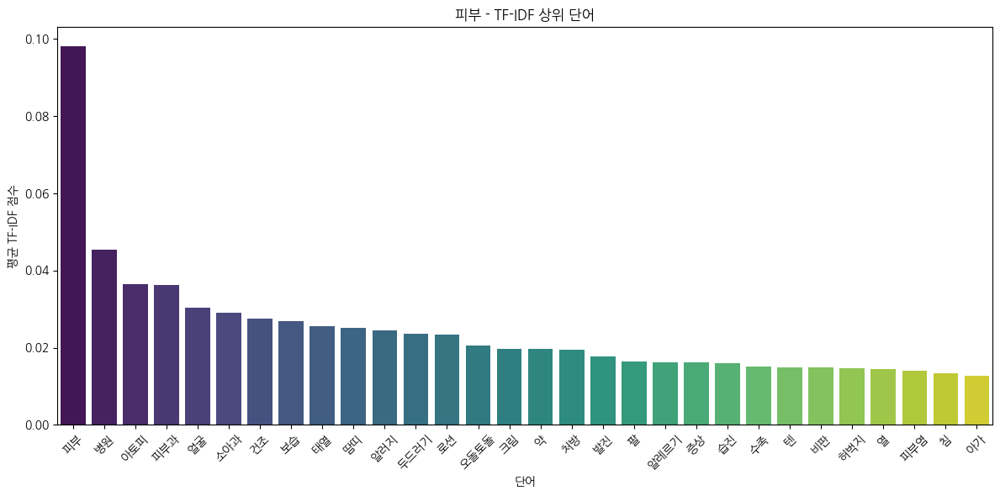

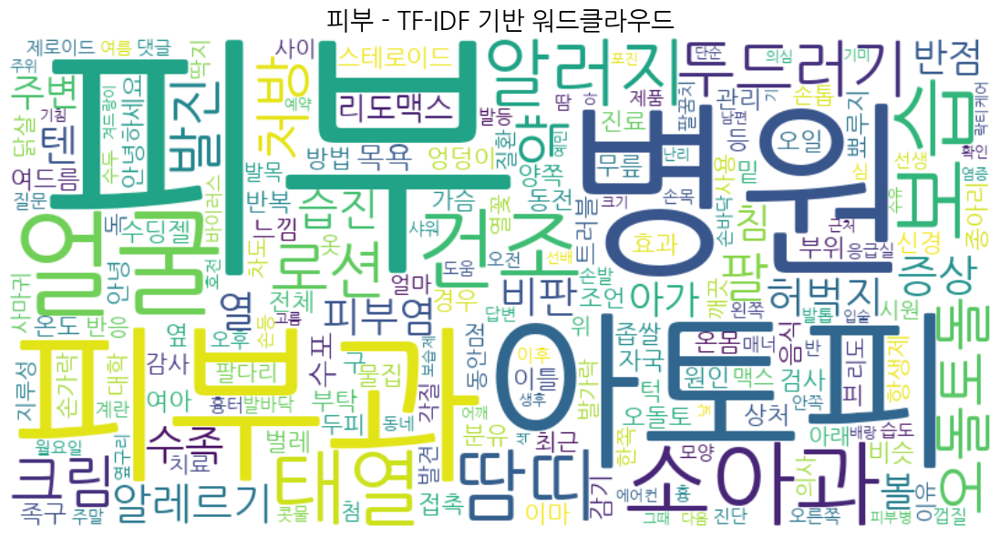


===== fever 키워드 데이터 분석 =====
fever 키워드 포함 문서 수: 16039


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


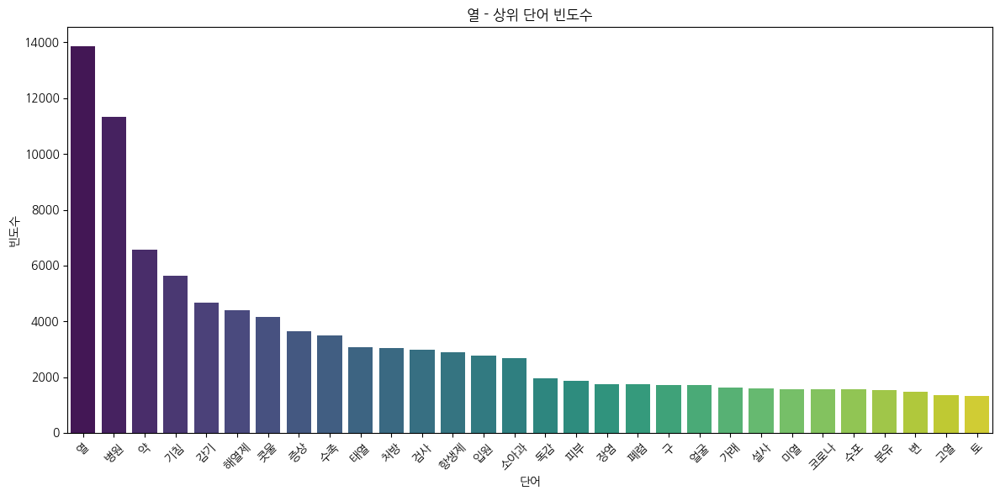

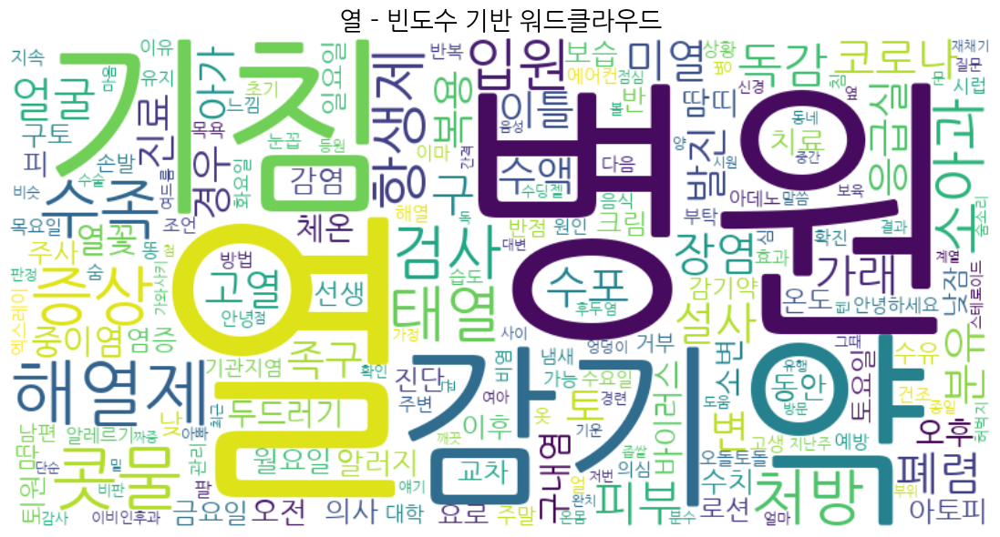

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


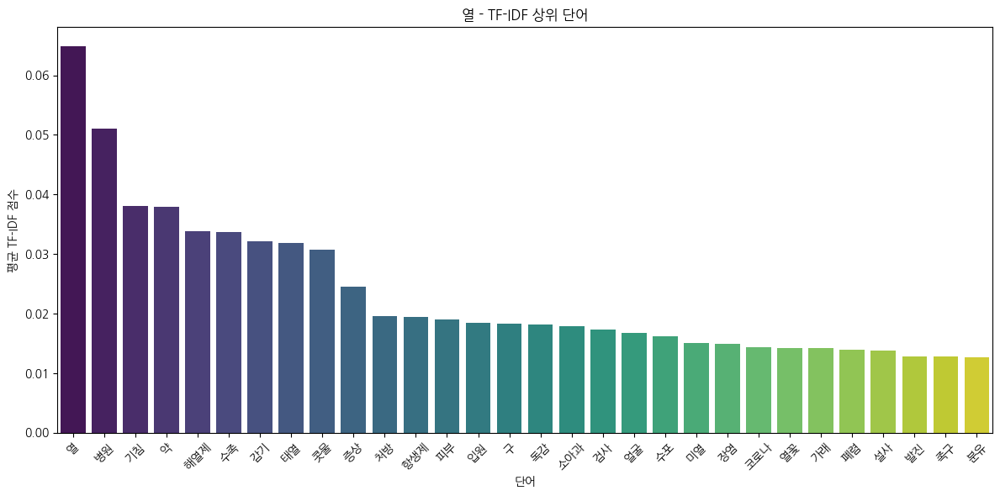

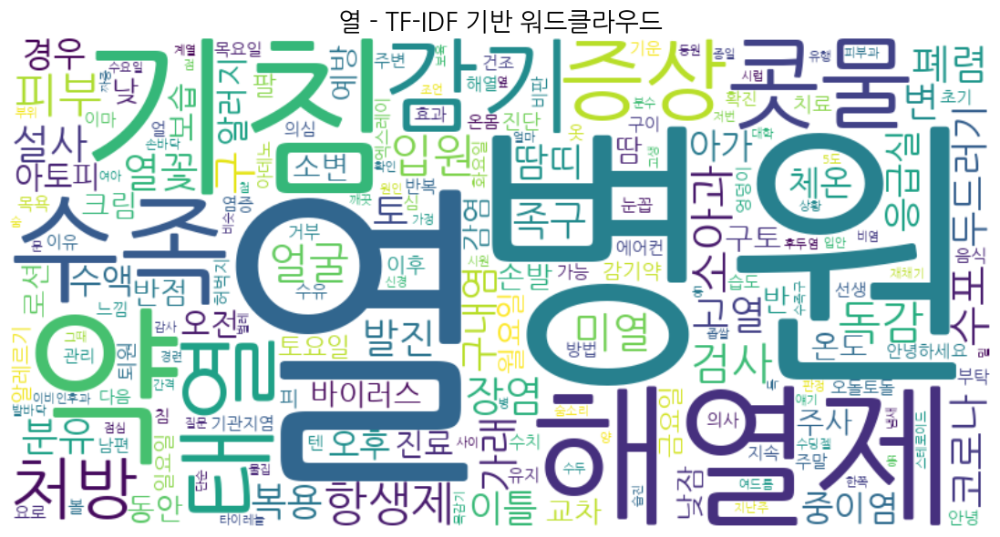


===== cough 키워드 데이터 분석 =====
cough 키워드 포함 문서 수: 5130


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


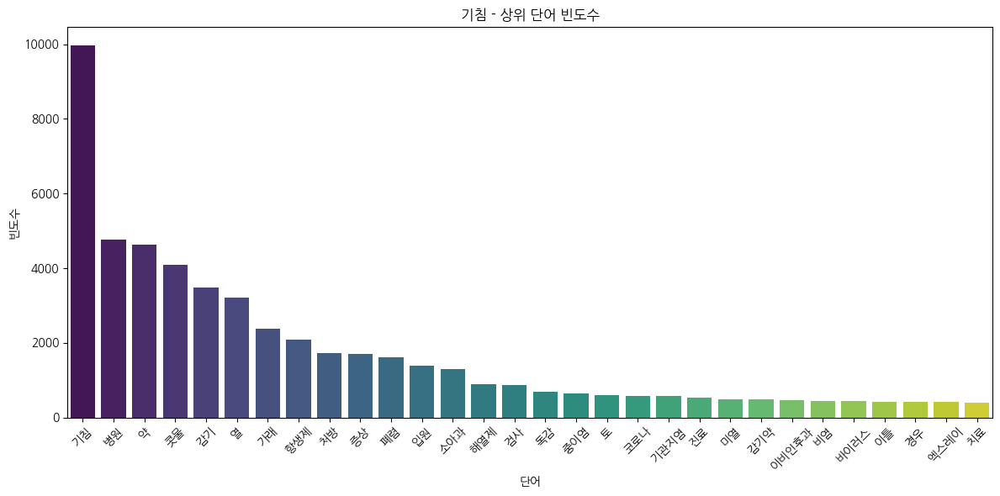

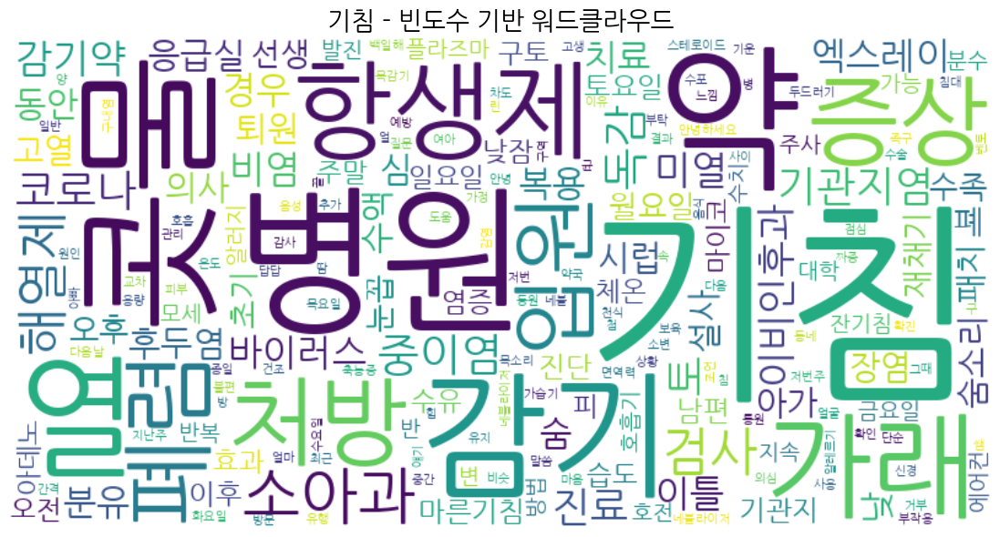

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


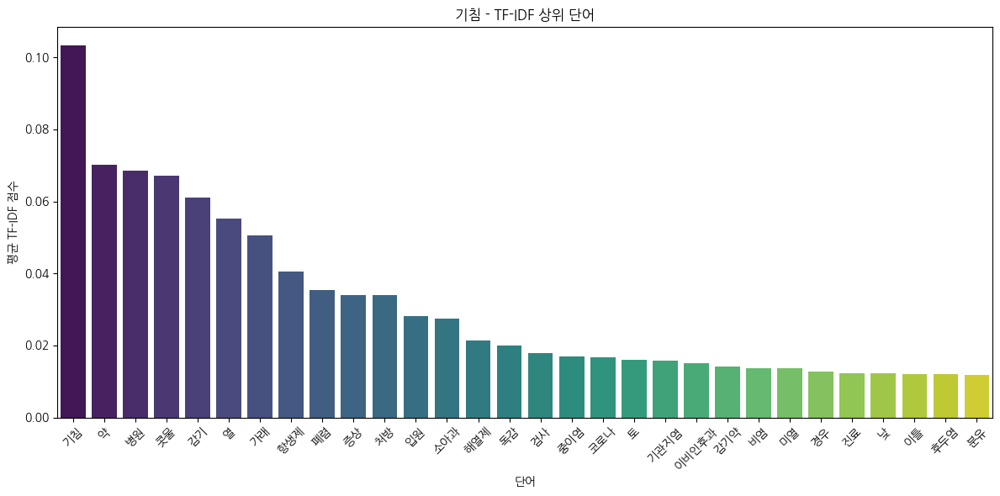

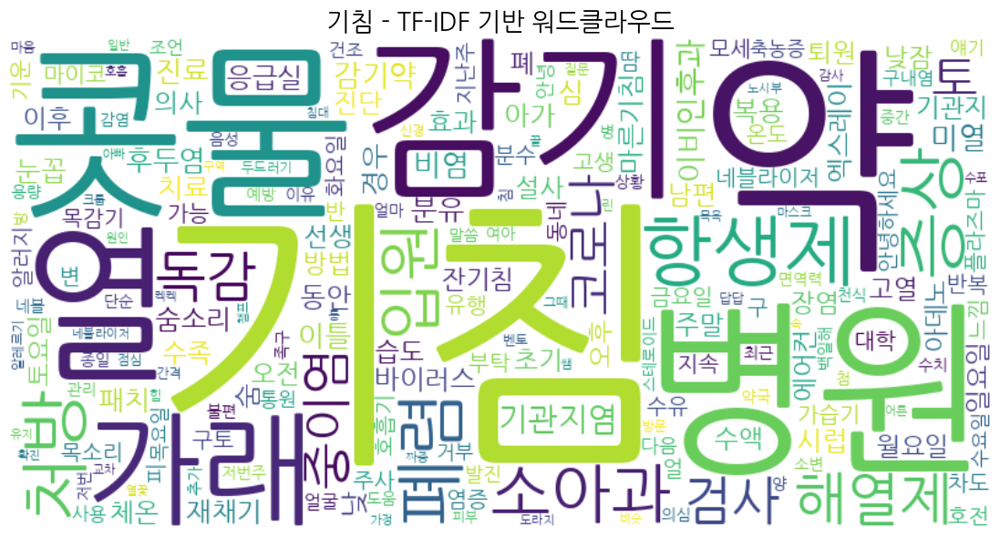


===== runny_nose 키워드 데이터 분석 =====
runny_nose 키워드 포함 문서 수: 4762


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


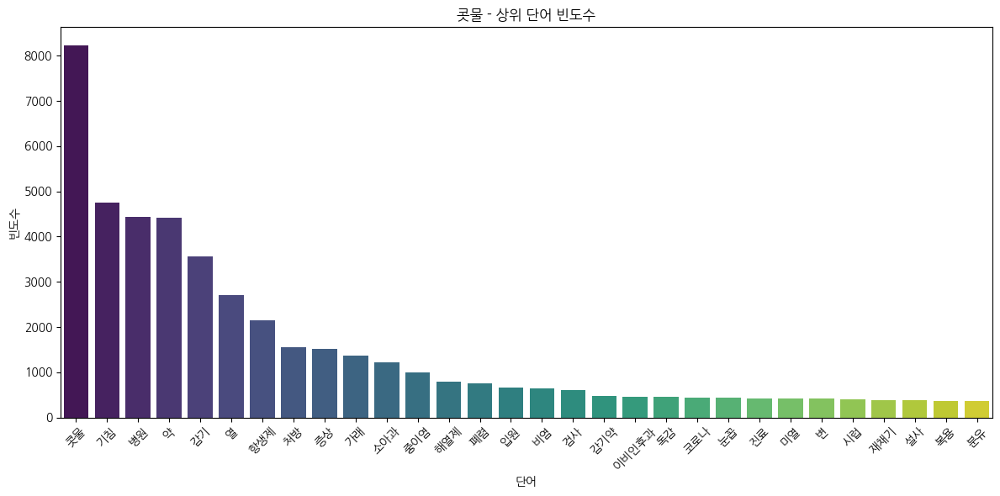

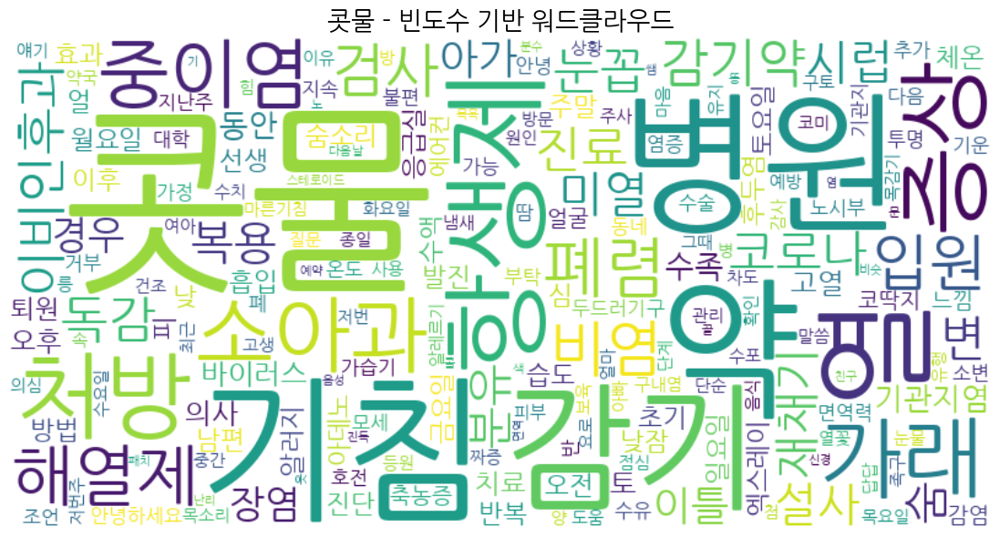

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


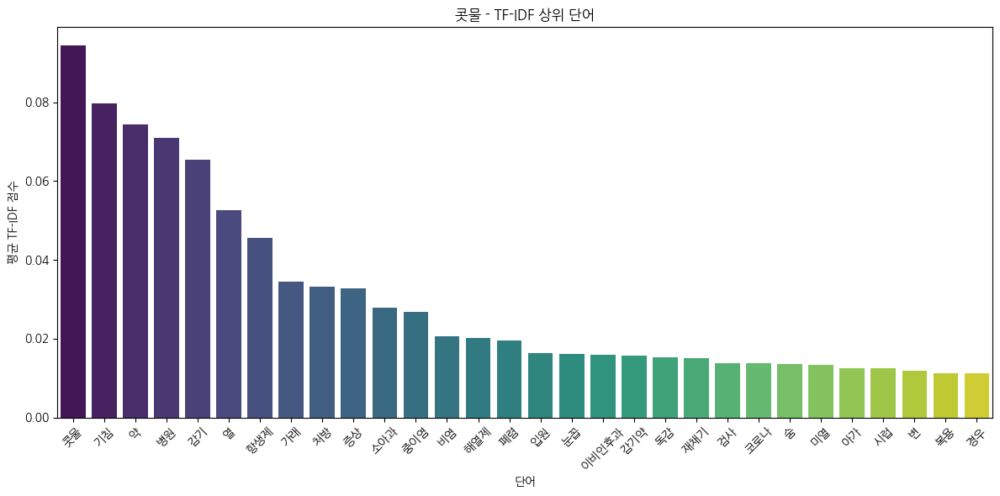

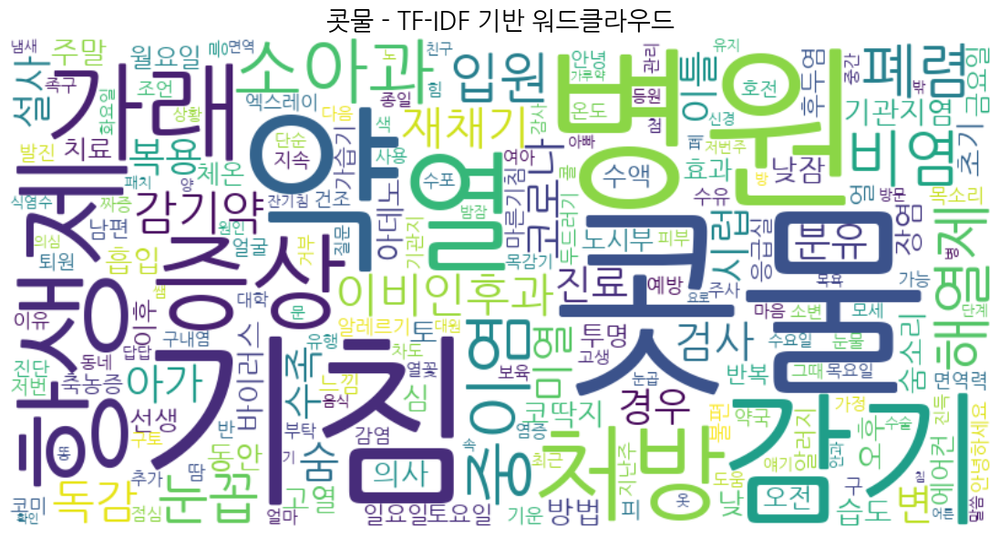


===== stool 키워드 데이터 분석 =====
stool 키워드 포함 문서 수: 9134


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


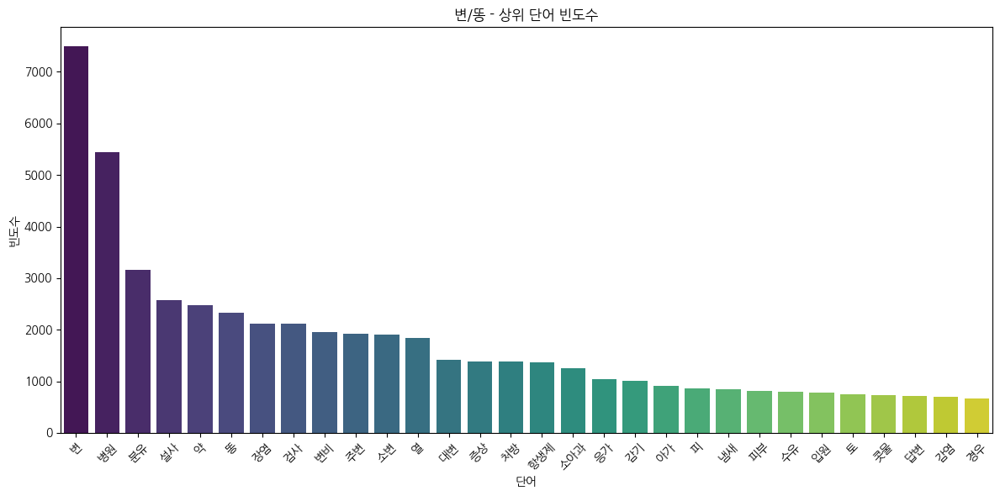

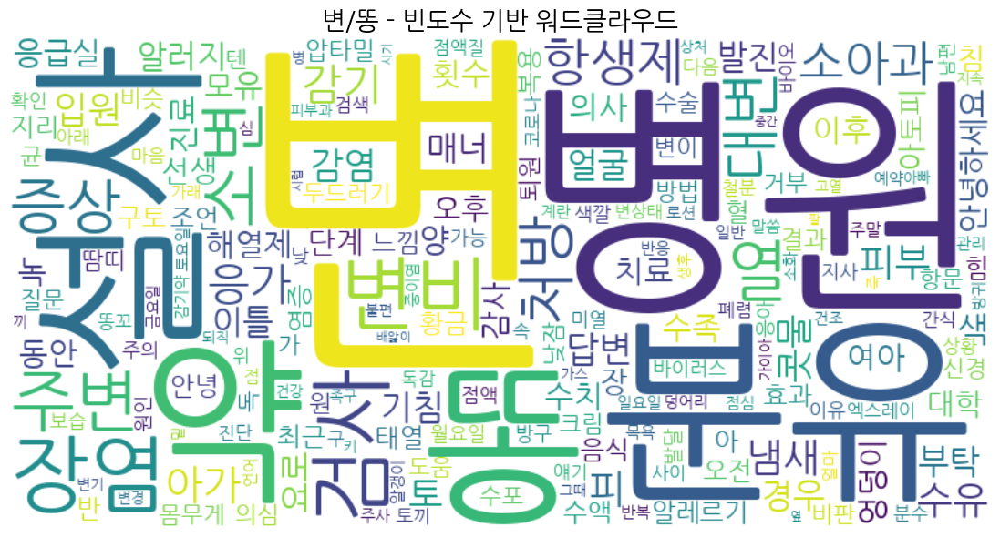

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


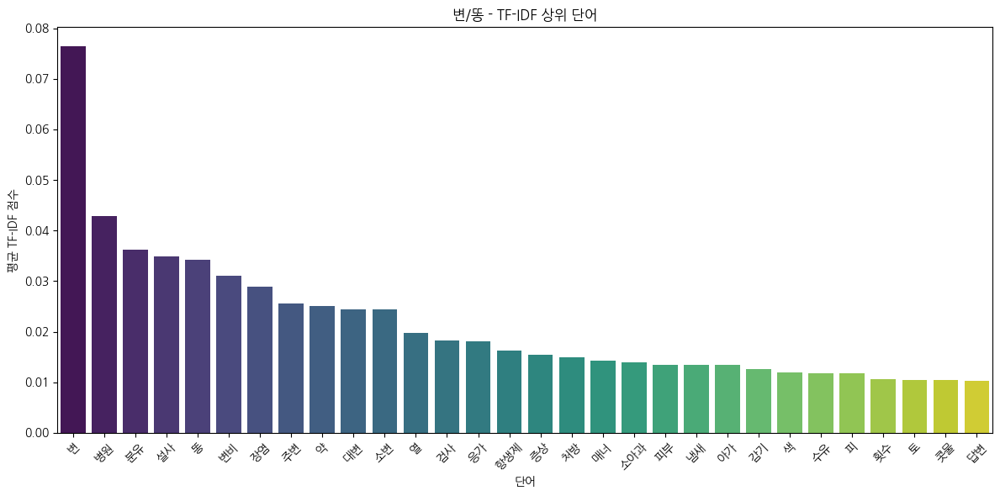

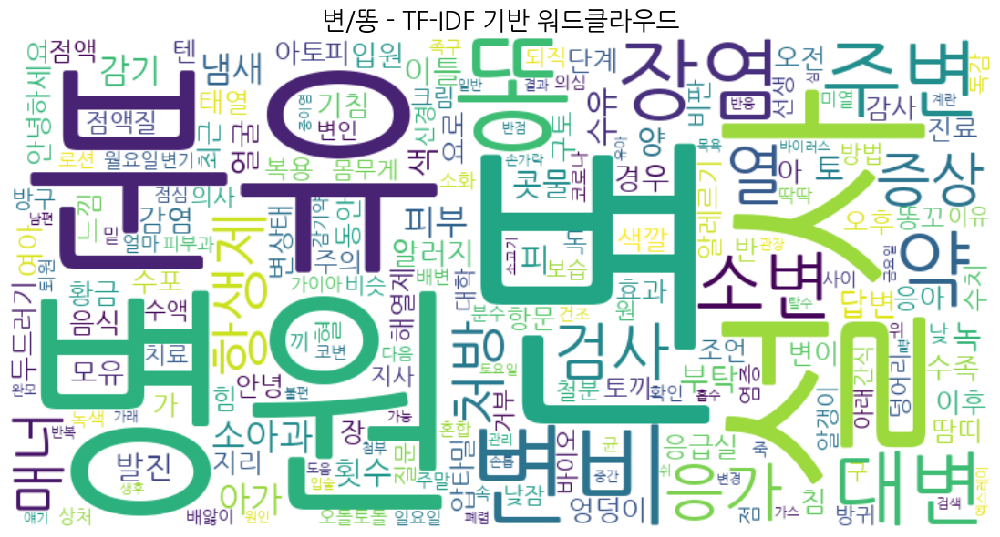


===== hand_foot 키워드 데이터 분석 =====
hand_foot 키워드 포함 문서 수: 4440


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


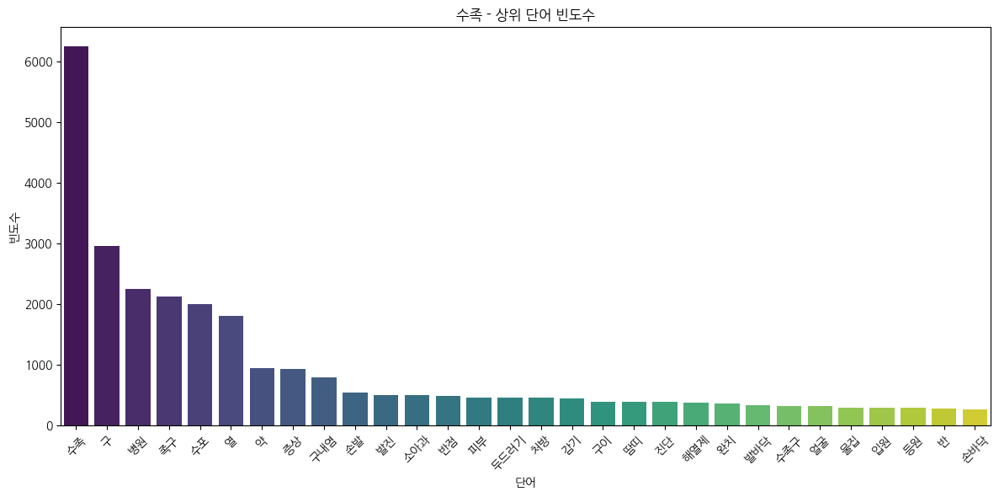

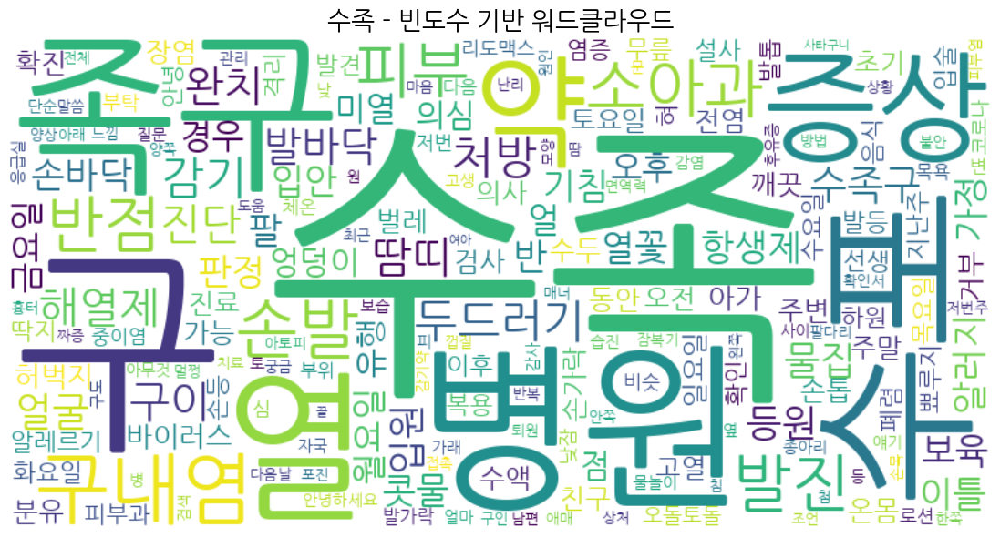

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


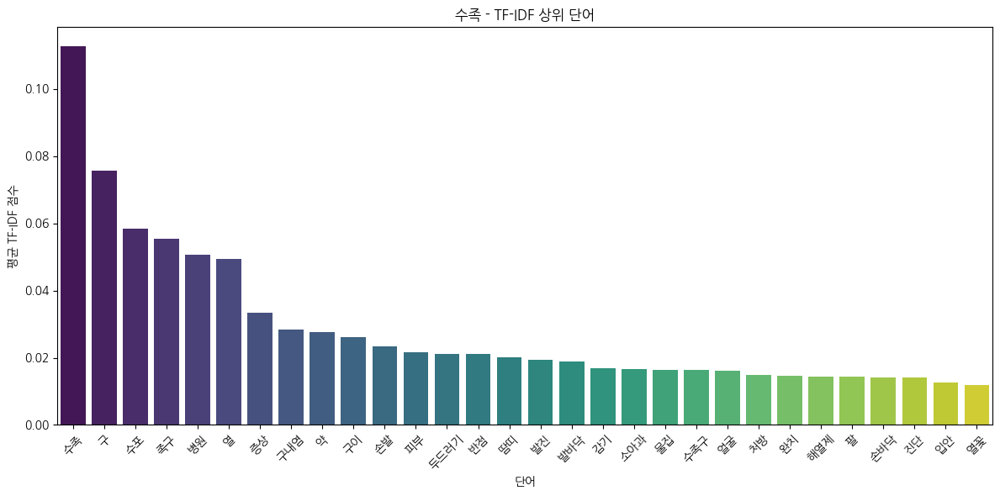

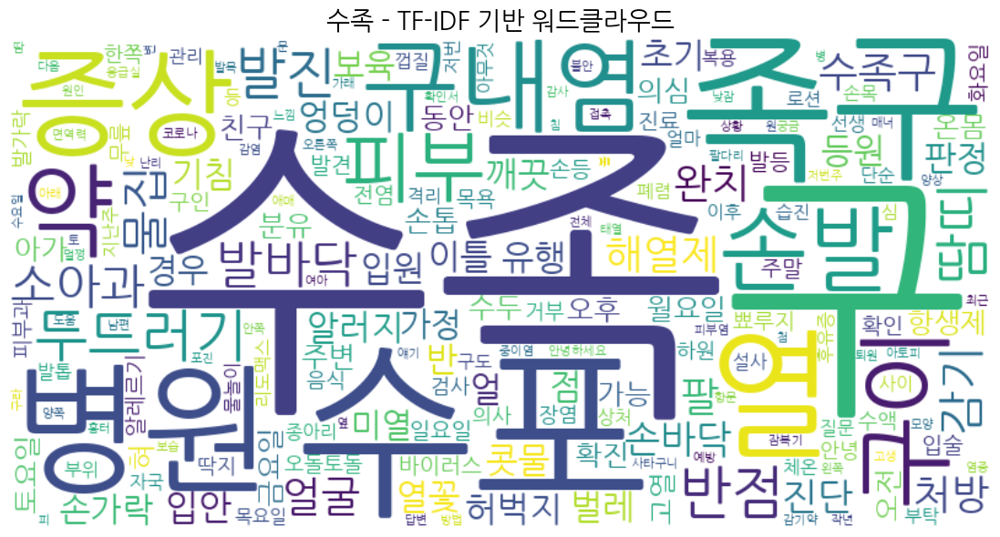


===== diarrhea 키워드 데이터 분석 =====
diarrhea 키워드 포함 문서 수: 3472


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


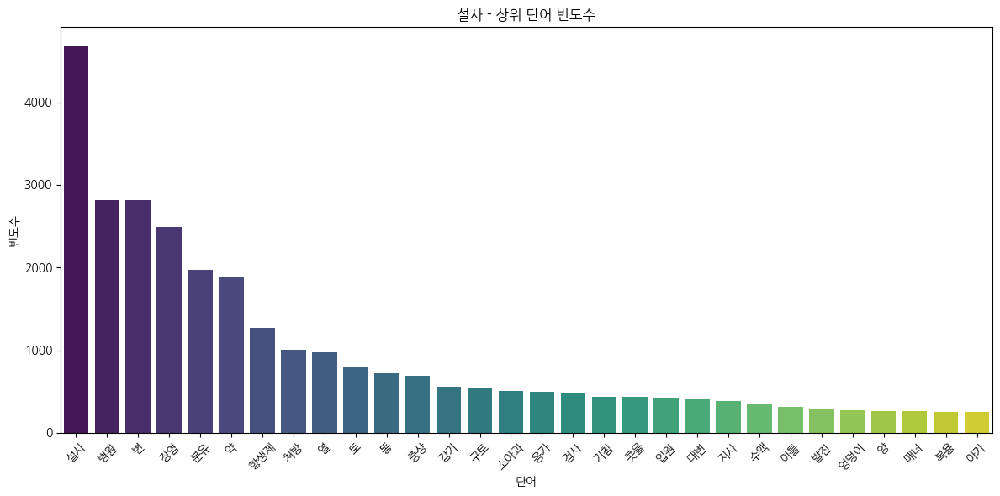

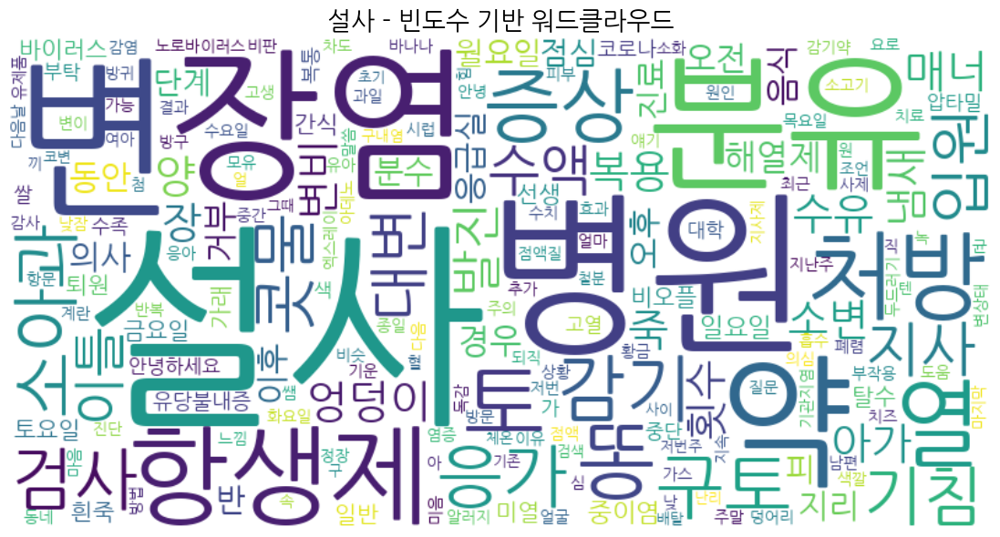

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


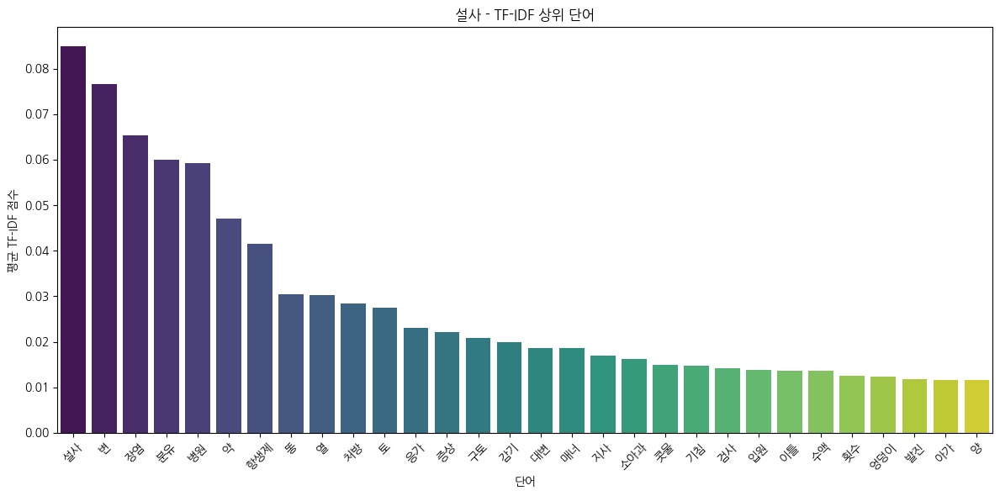

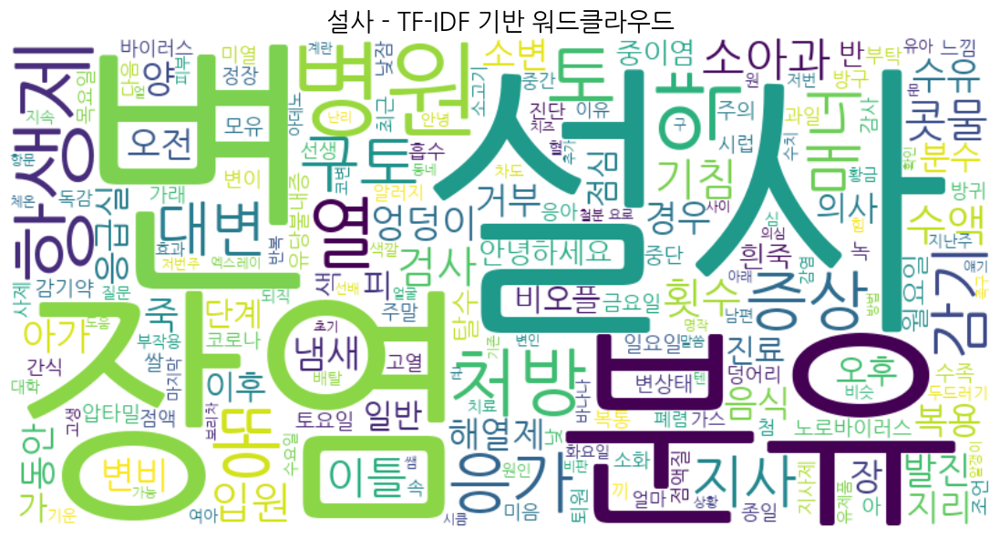


===== allergy 키워드 데이터 분석 =====
allergy 키워드 포함 문서 수: 3793


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


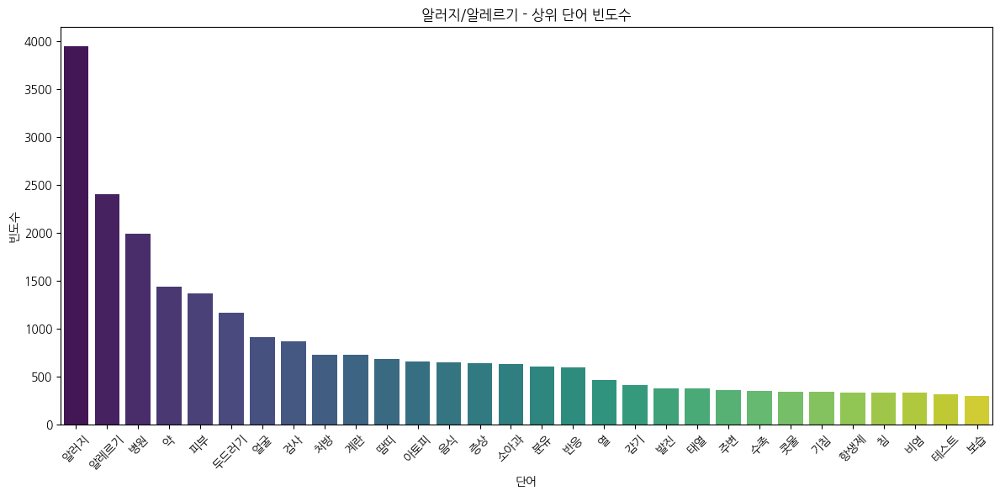

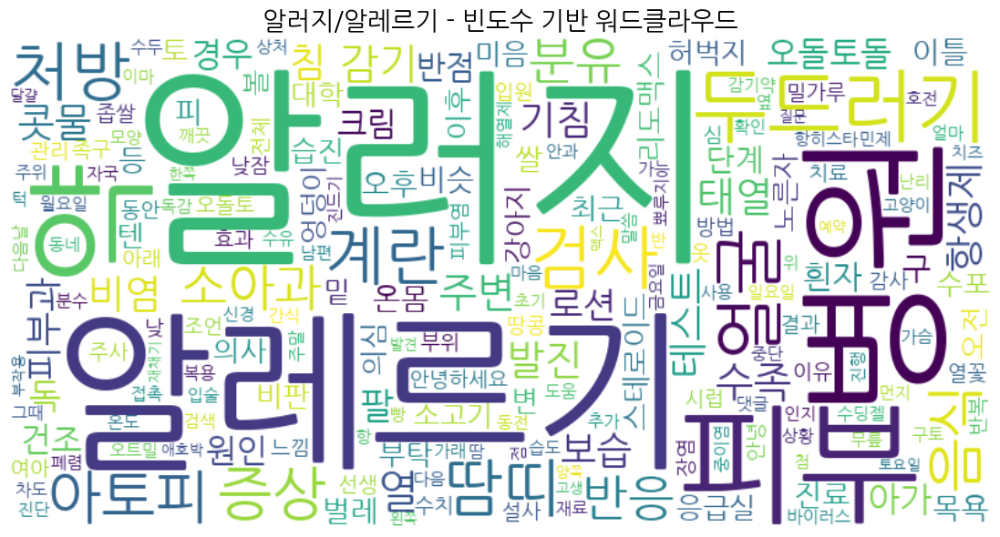

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


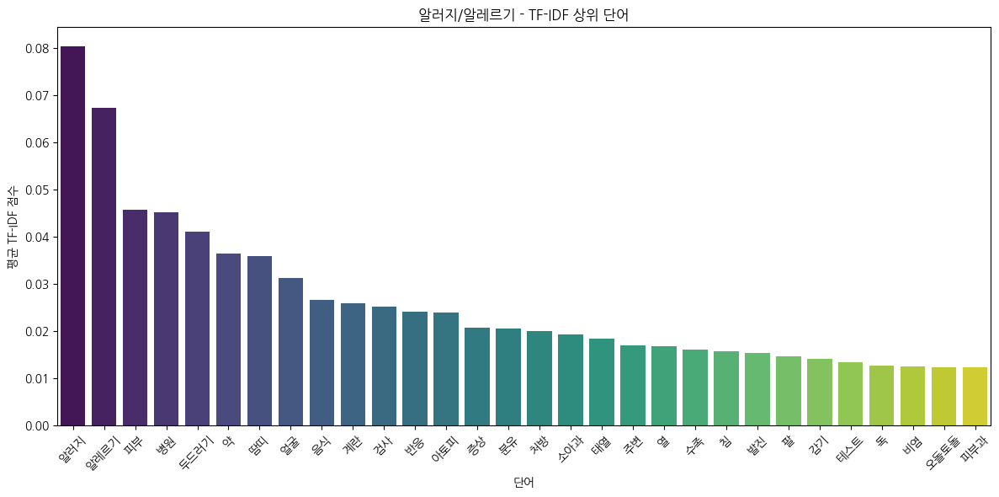

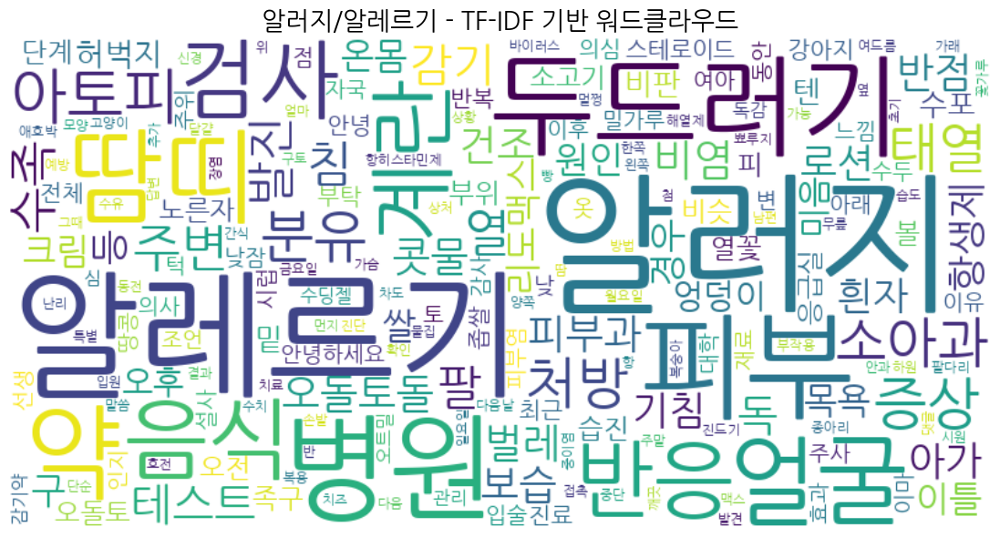


===== atopy 키워드 데이터 분석 =====
atopy 키워드 포함 문서 수: 2091


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


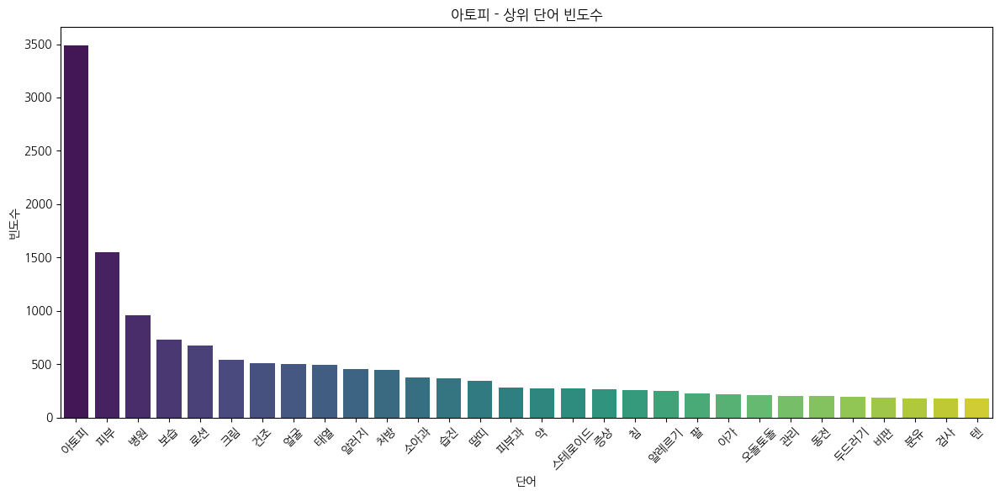

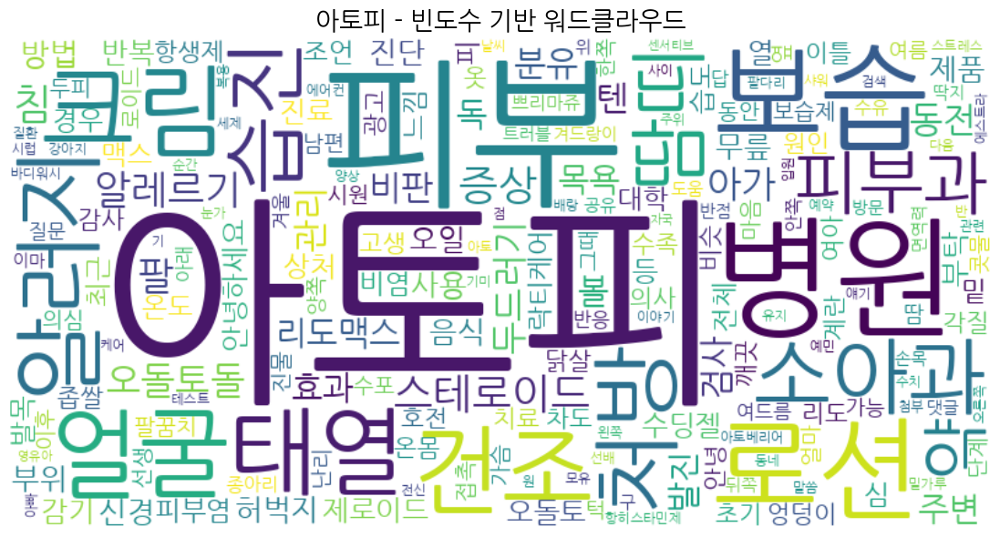

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


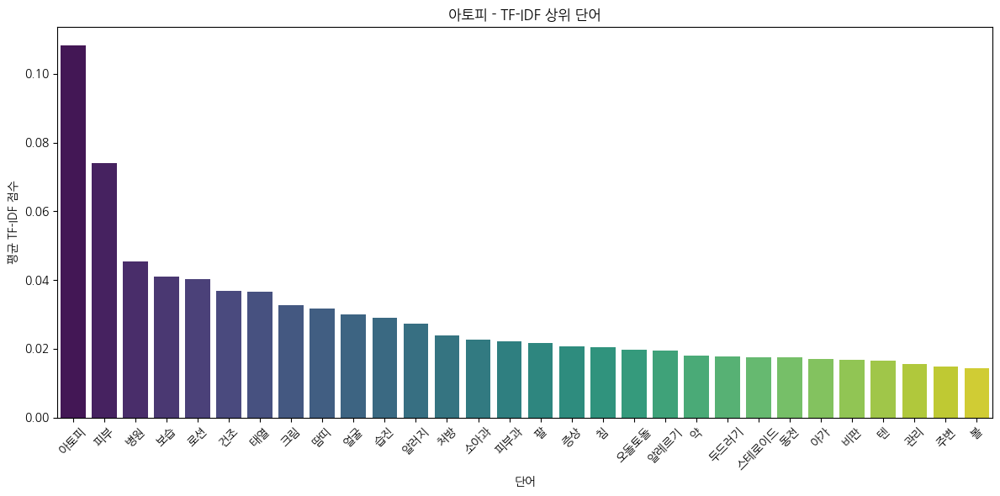

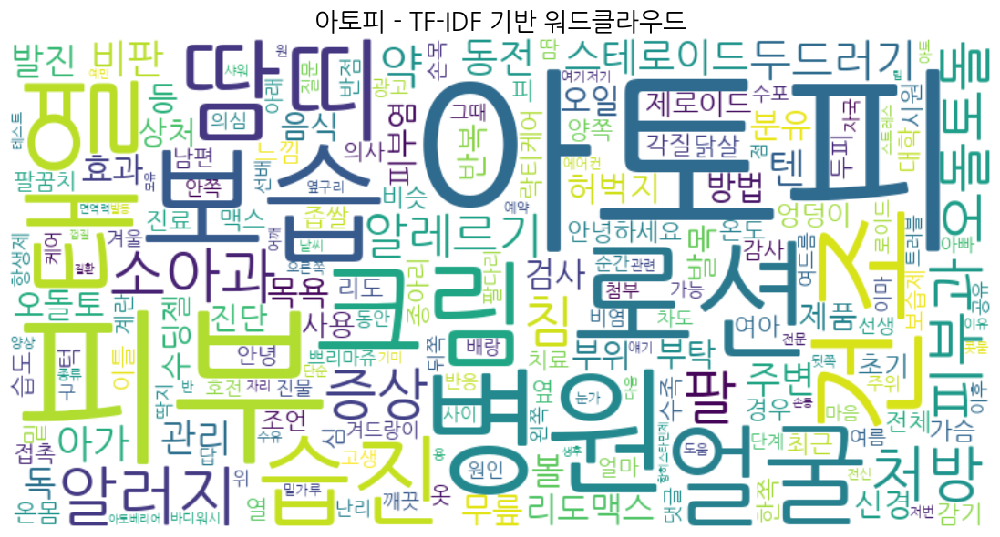


===== urticaria 키워드 데이터 분석 =====
urticaria 키워드 포함 문서 수: 2146


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


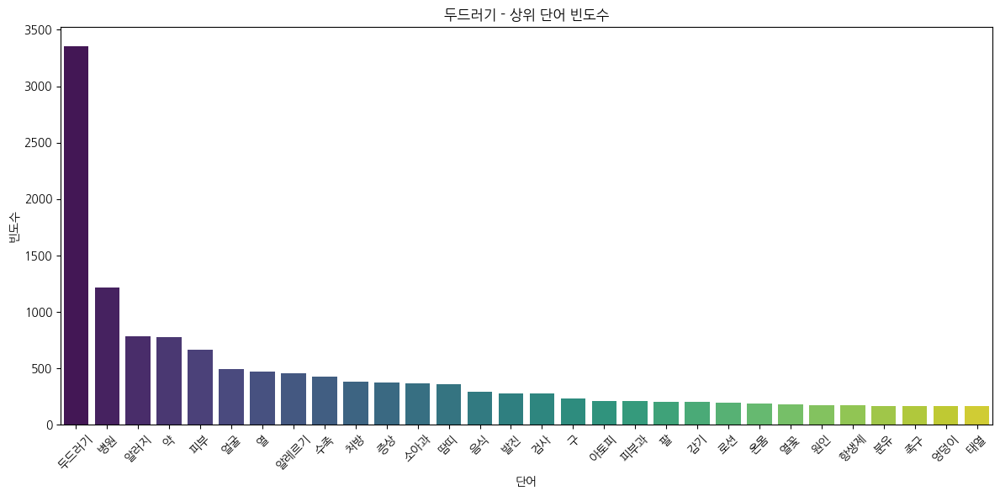

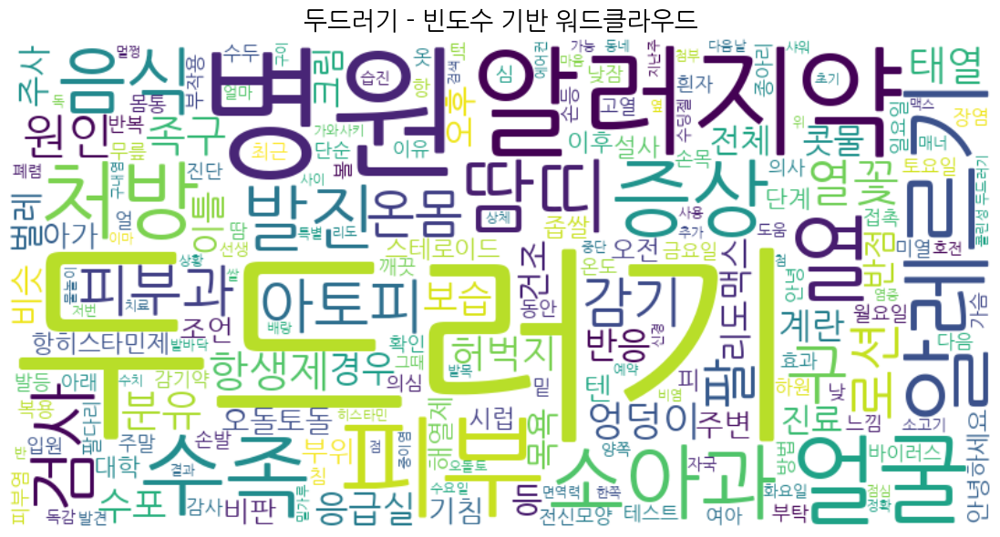

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


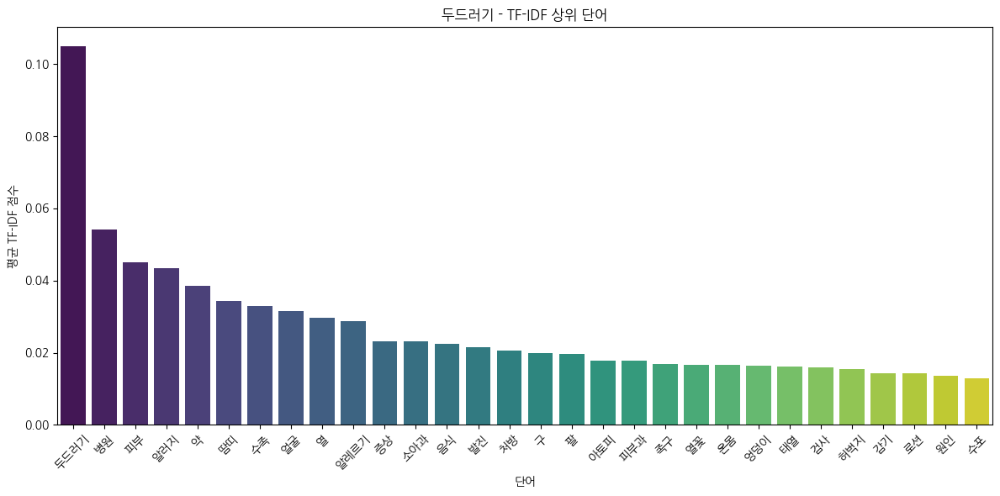

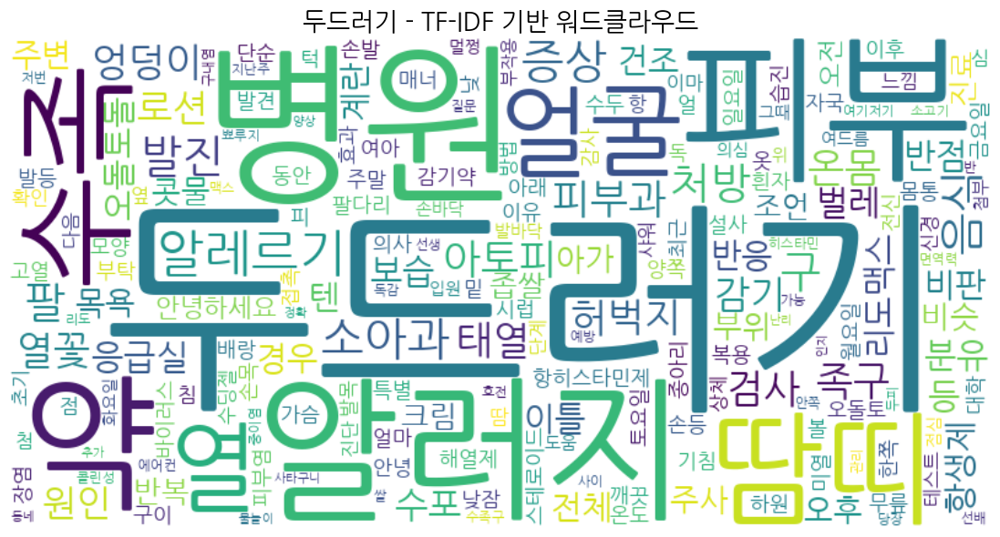


===== vomit 키워드 데이터 분석 =====
vomit 키워드 포함 문서 수: 8805


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


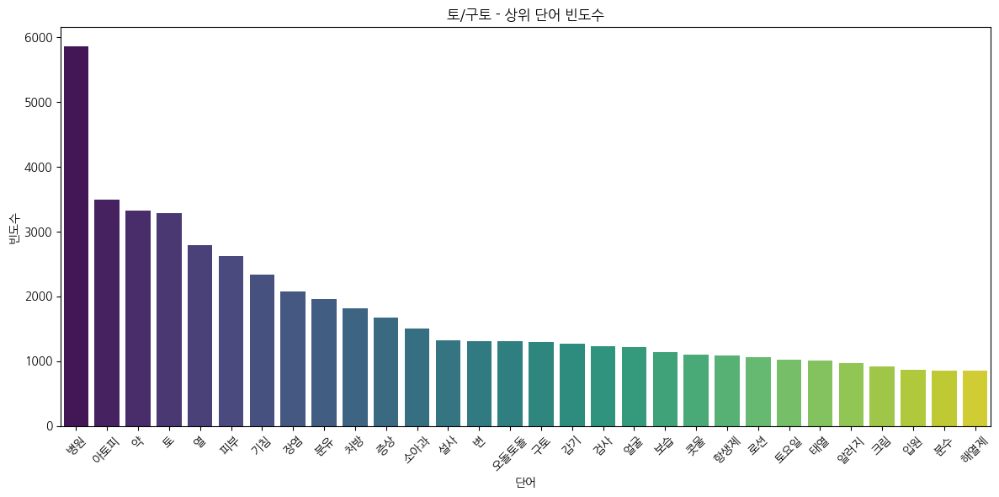

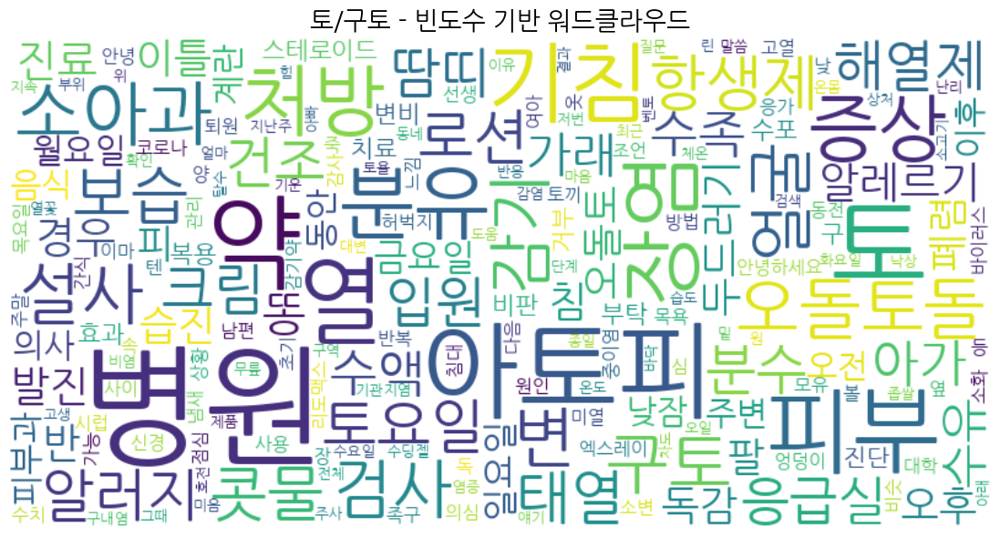

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


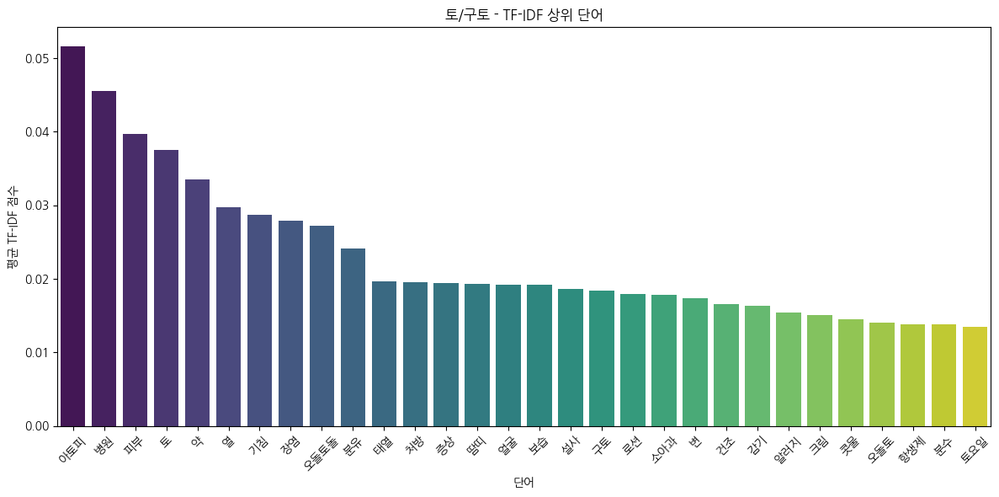

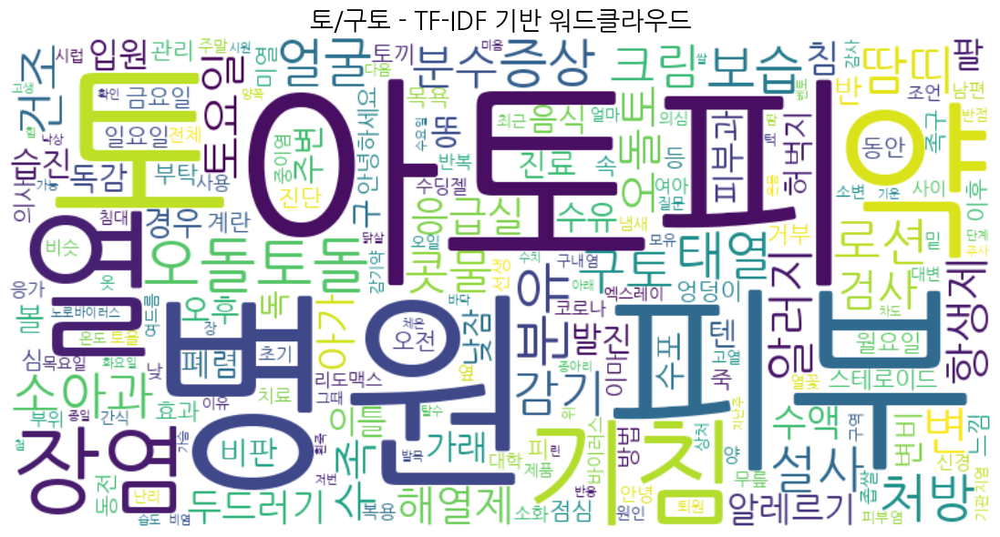


===== blood 키워드 데이터 분석 =====
blood 키워드 포함 문서 수: 12224


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


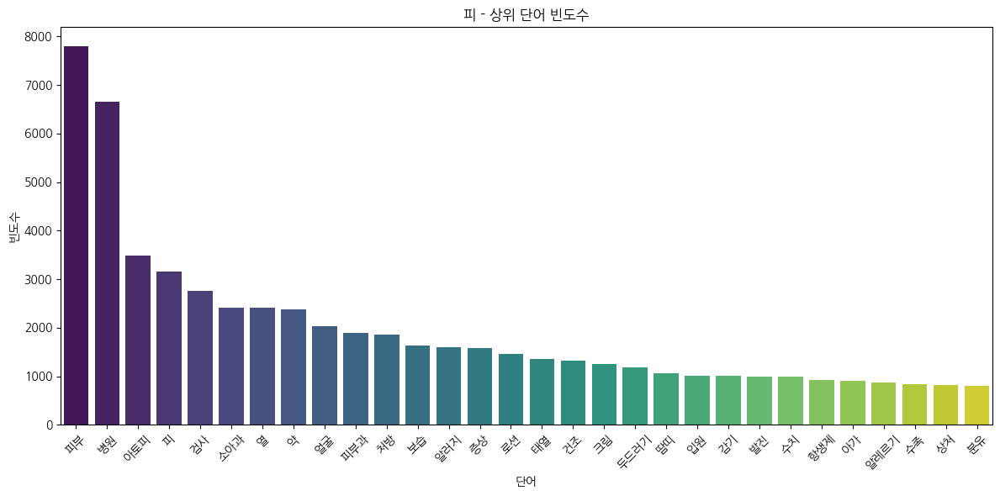

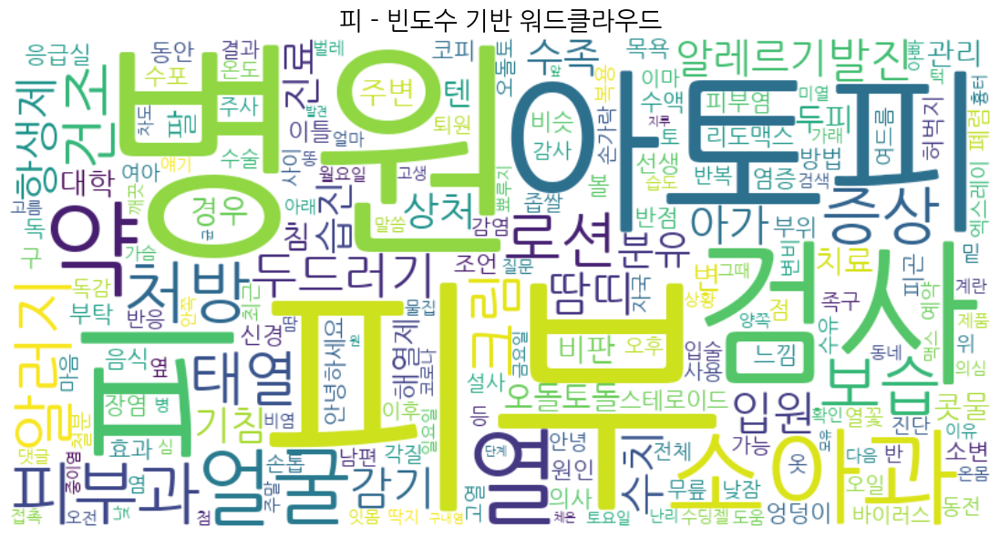

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


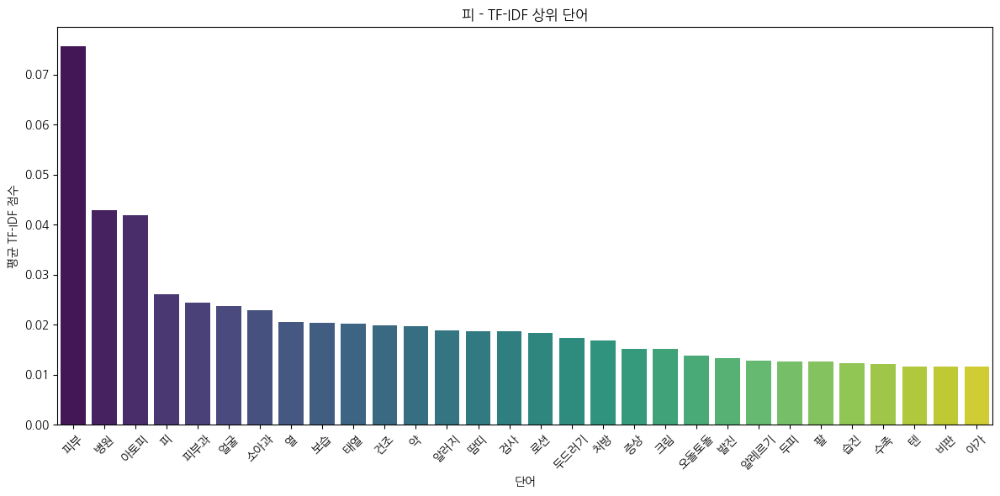

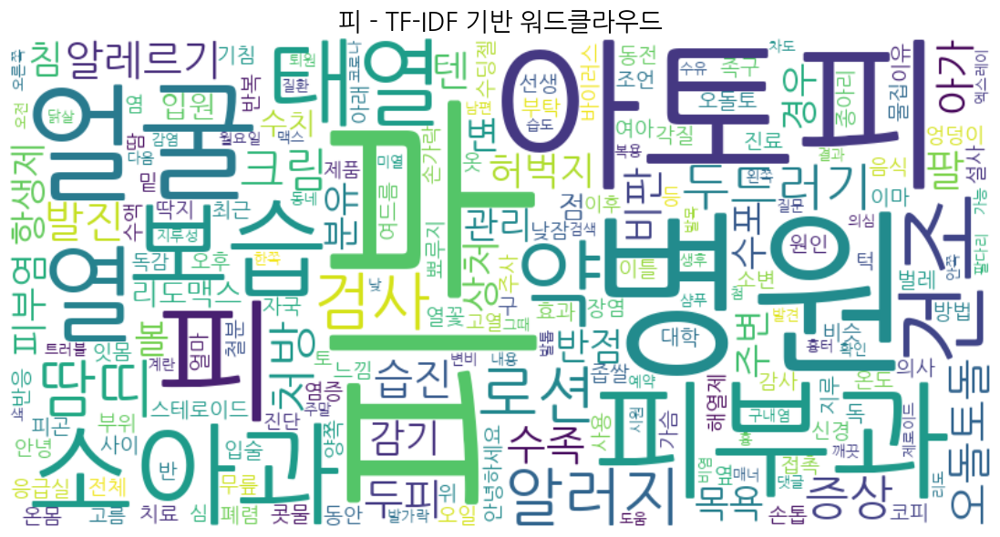


===== heat_rash 키워드 데이터 분석 =====
heat_rash 키워드 포함 문서 수: 2039


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


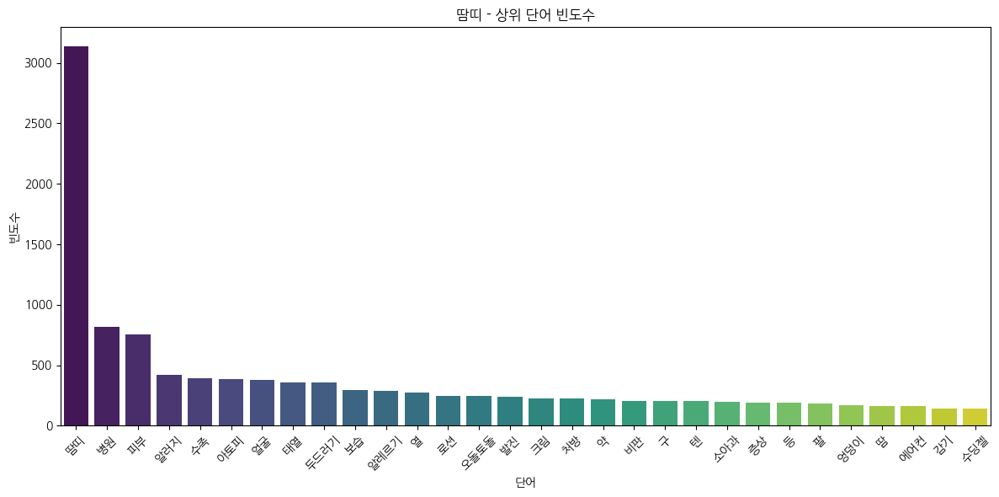

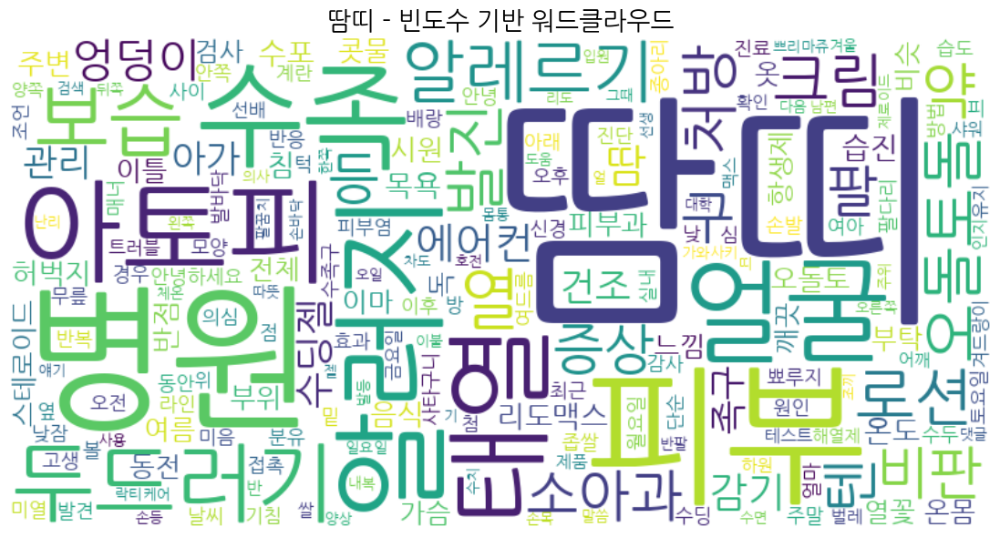

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


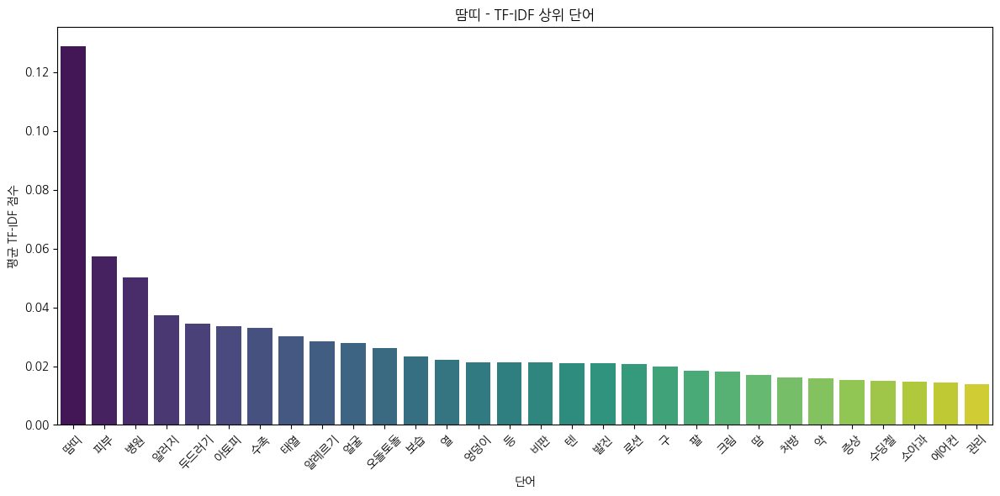

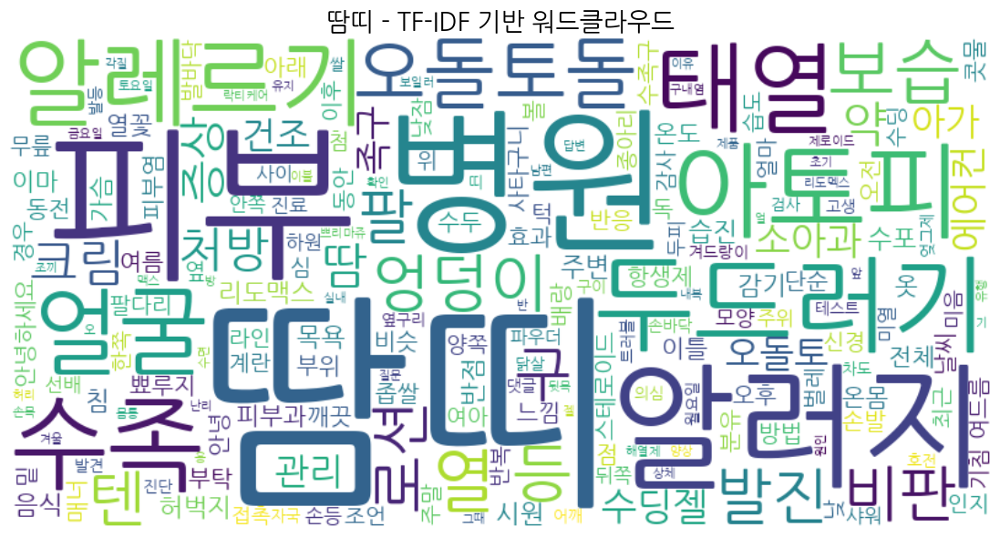


===== seborrheic 키워드 데이터 분석 =====
seborrheic 키워드 포함 문서 수: 1880


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


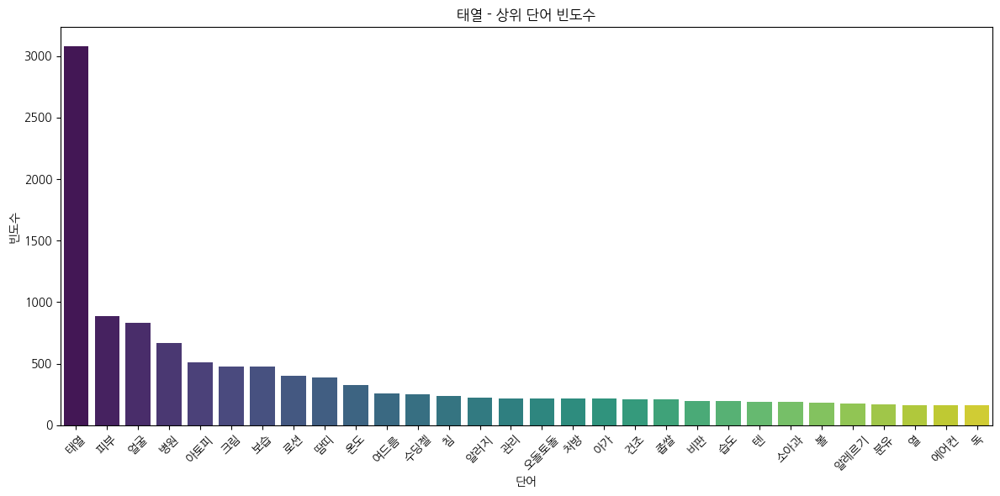

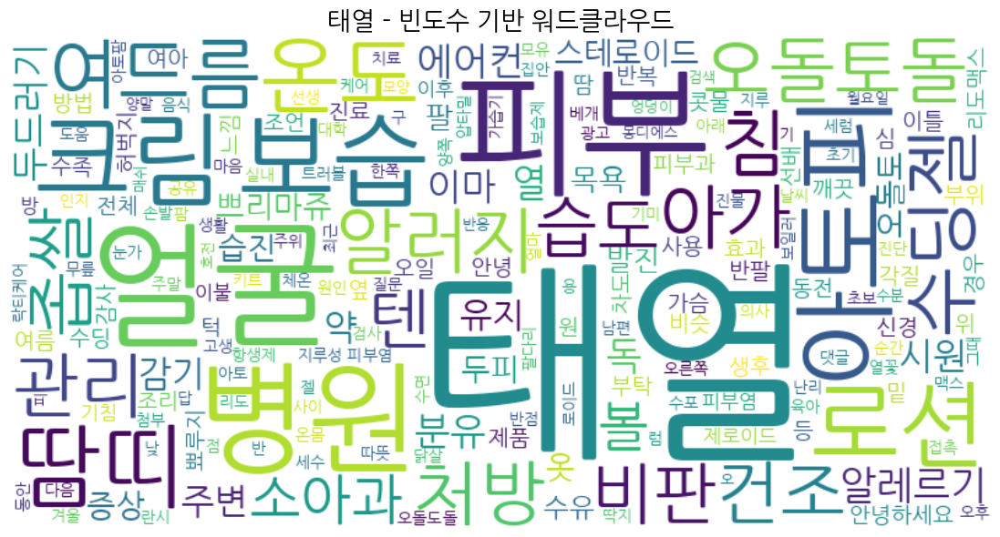

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


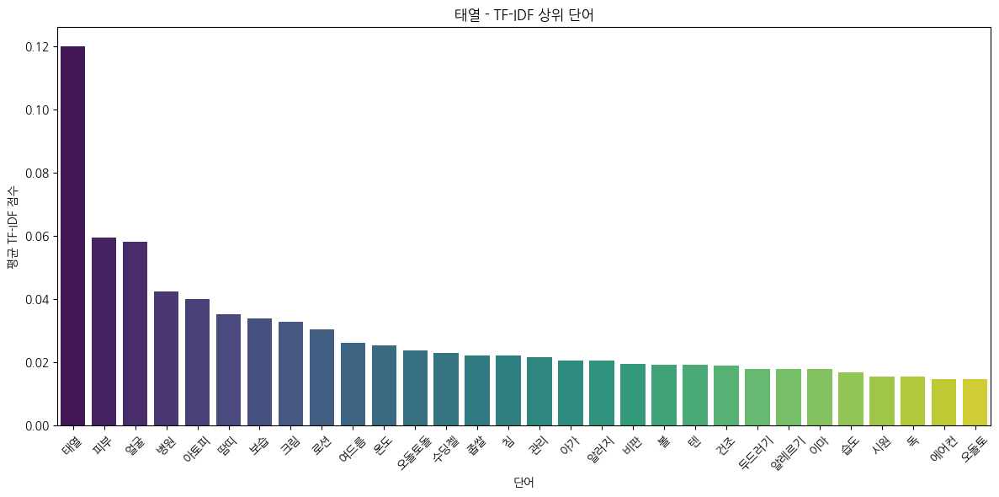

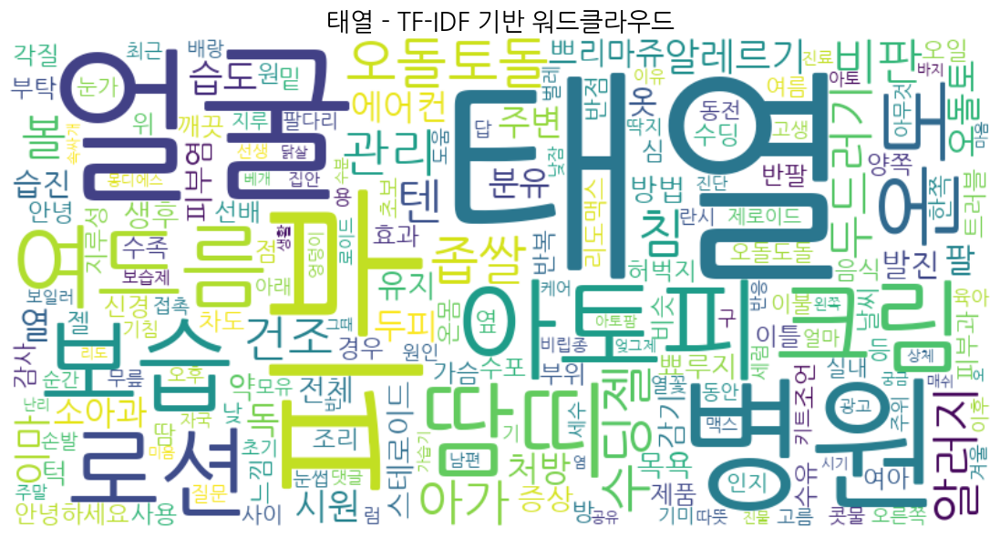


===== flu 키워드 데이터 분석 =====
flu 키워드 포함 문서 수: 1631


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


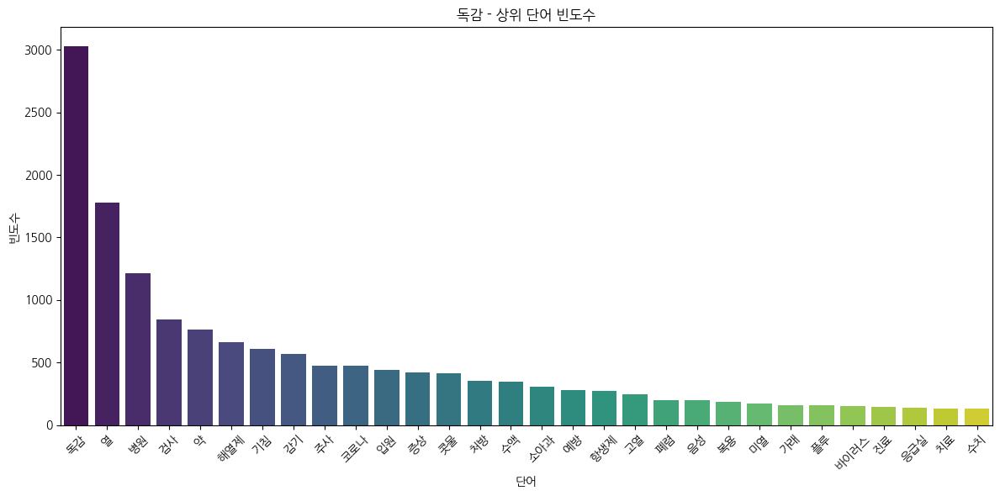

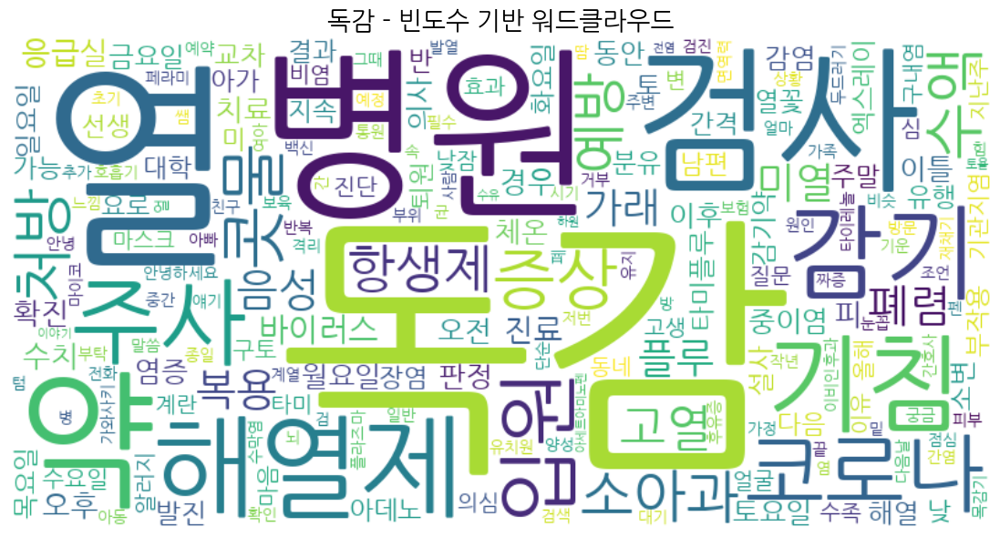

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


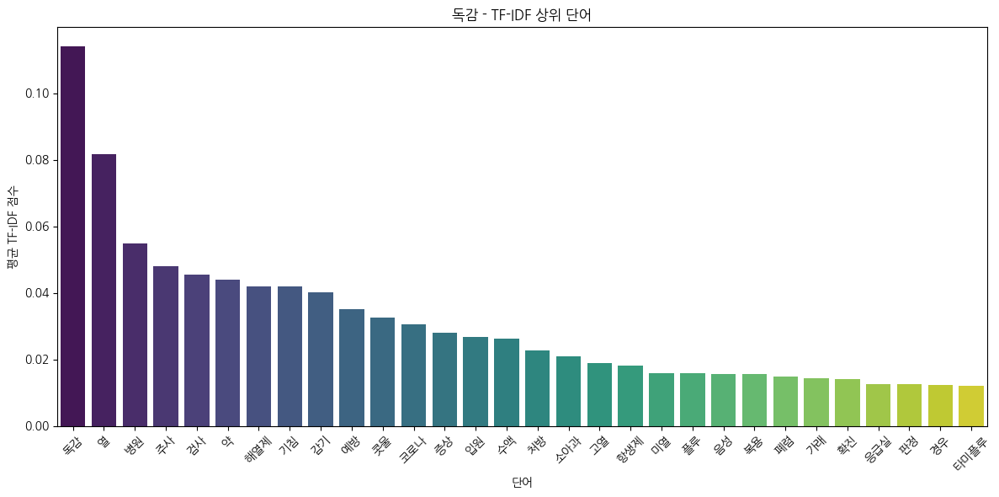

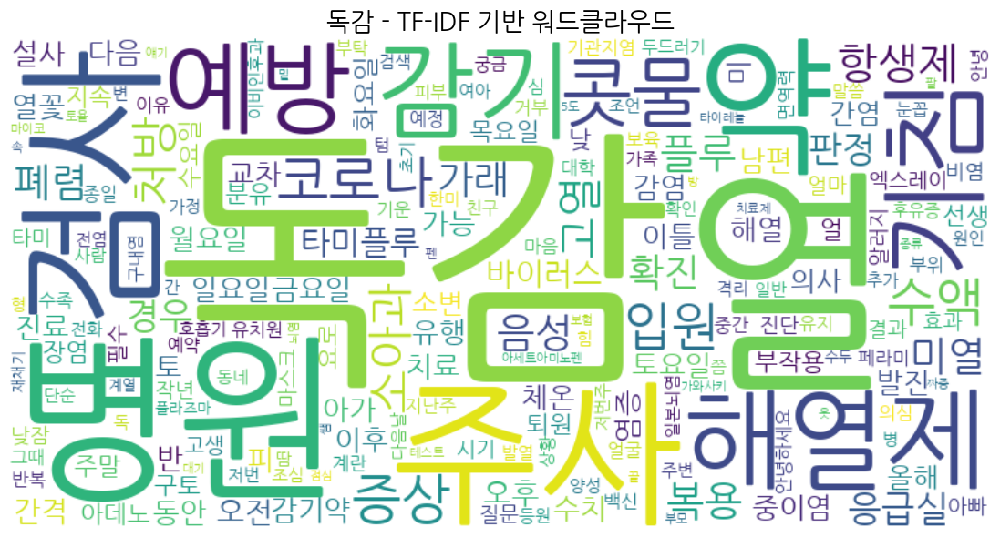


===== pneumonia 키워드 데이터 분석 =====
pneumonia 키워드 포함 문서 수: 1747


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


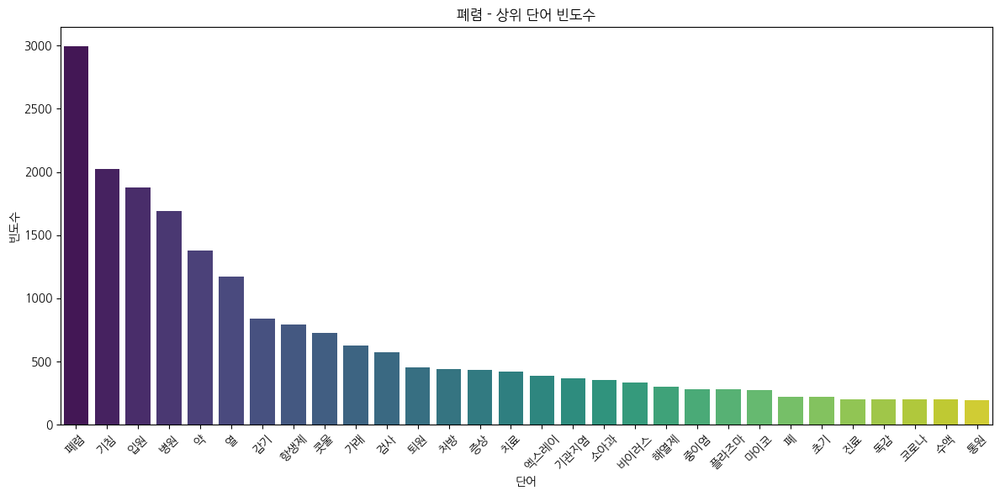

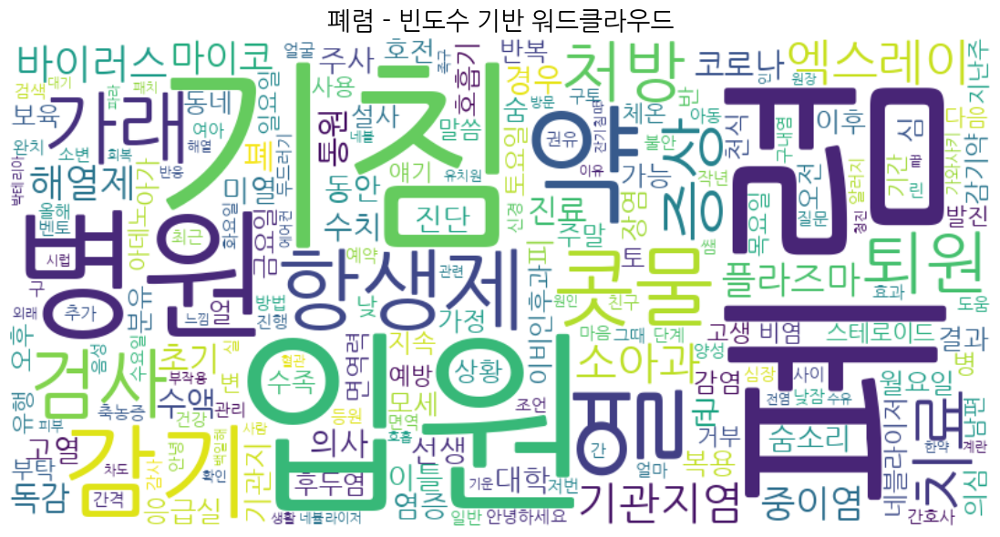

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


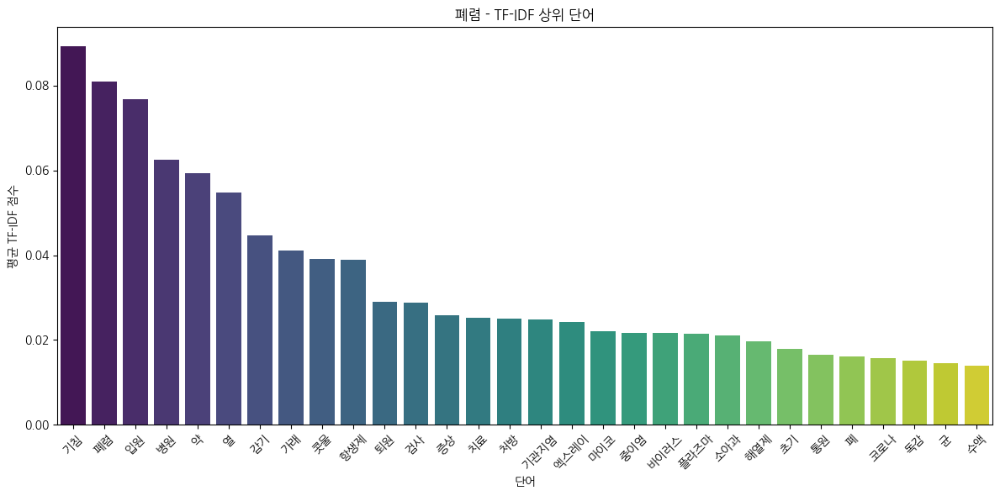

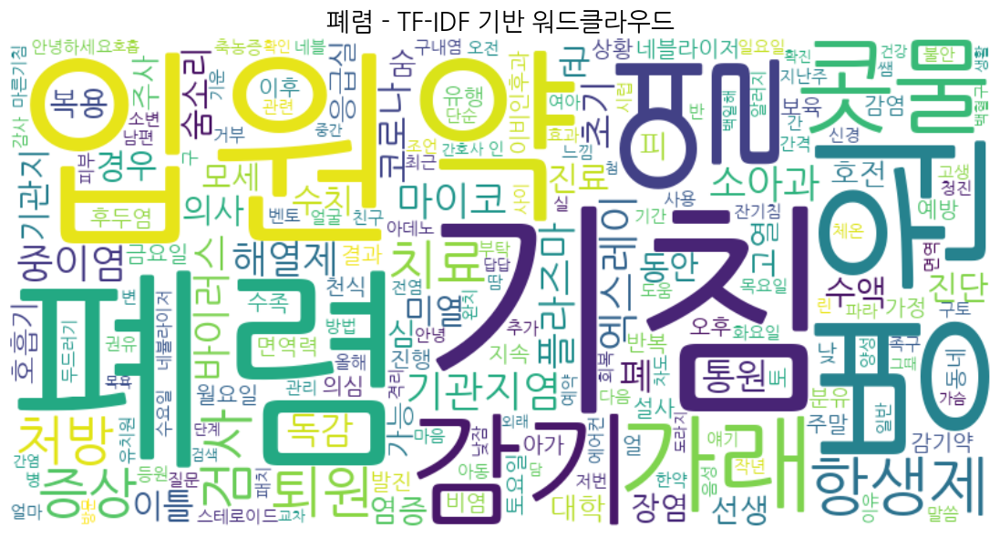


===== phlegm 키워드 데이터 분석 =====
phlegm 키워드 포함 문서 수: 1938


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


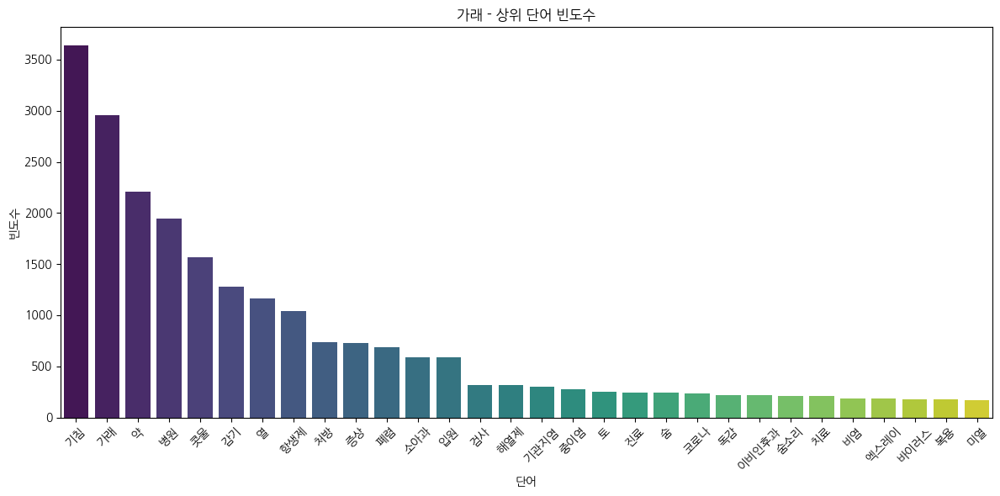

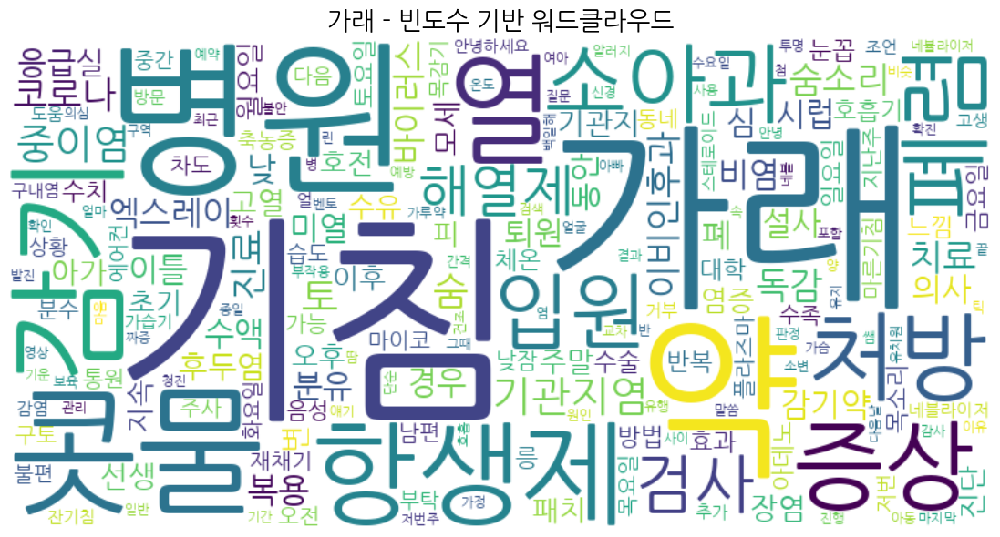

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


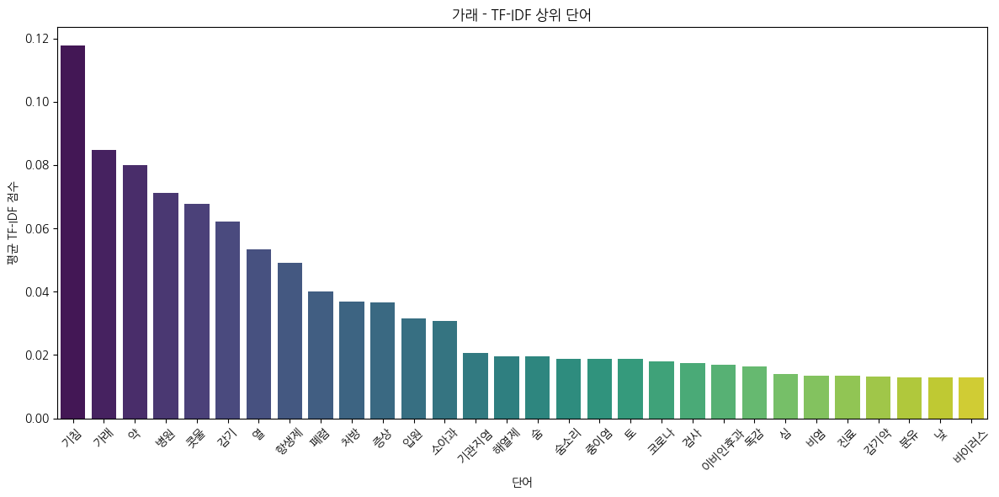

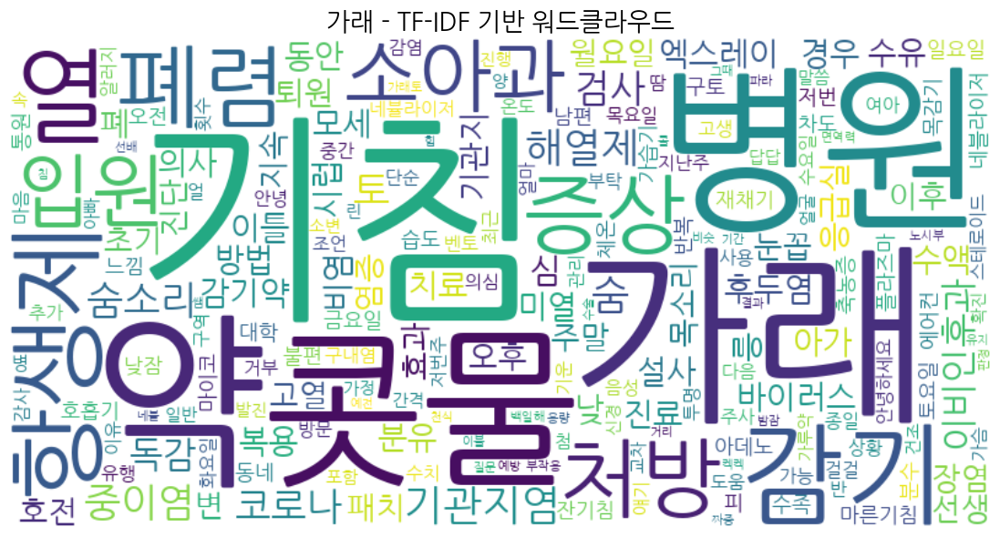


===== rash 키워드 데이터 분석 =====
rash 키워드 포함 문서 수: 1897


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


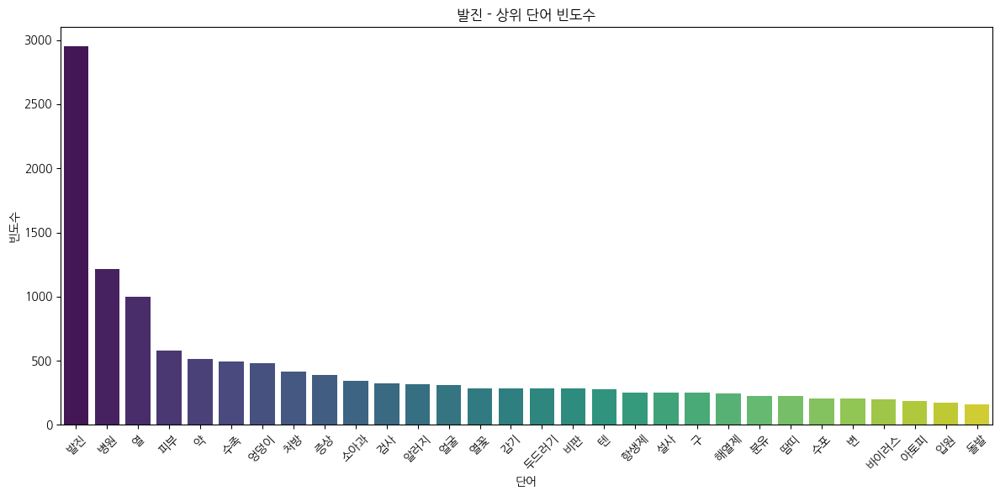

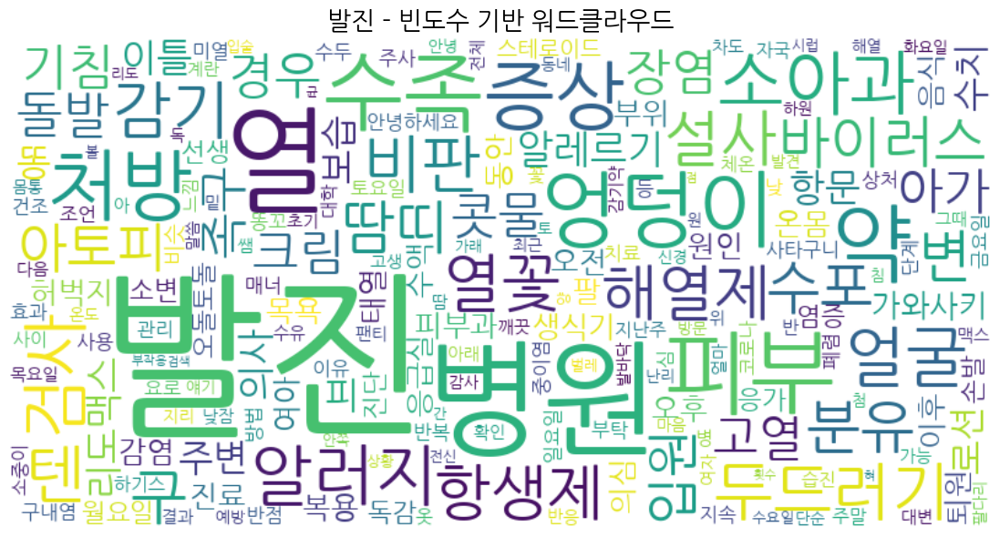

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


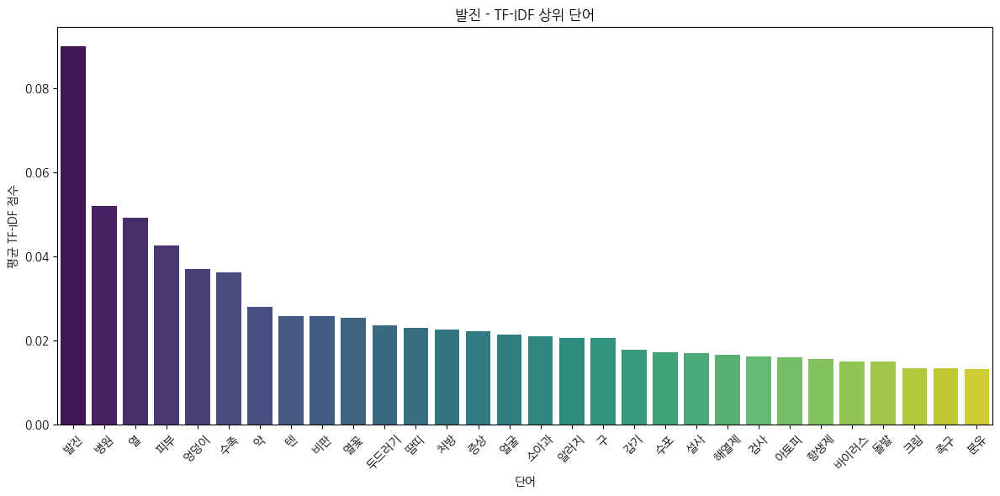

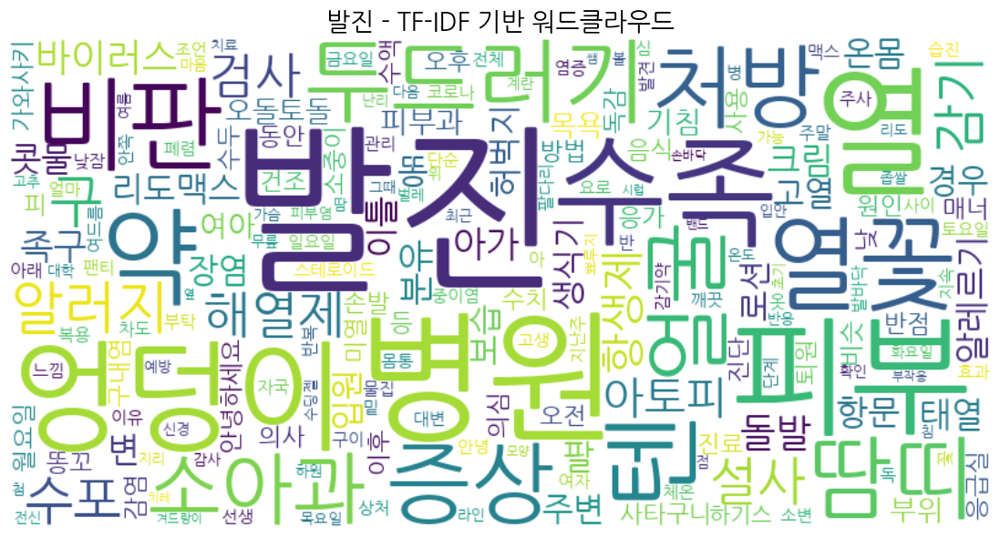


===== blister 키워드 데이터 분석 =====
blister 키워드 포함 문서 수: 1774


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


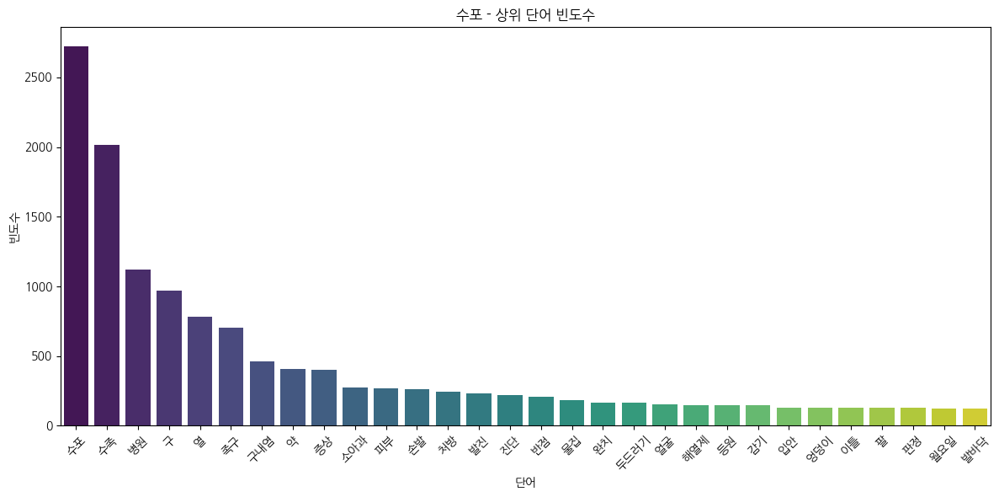

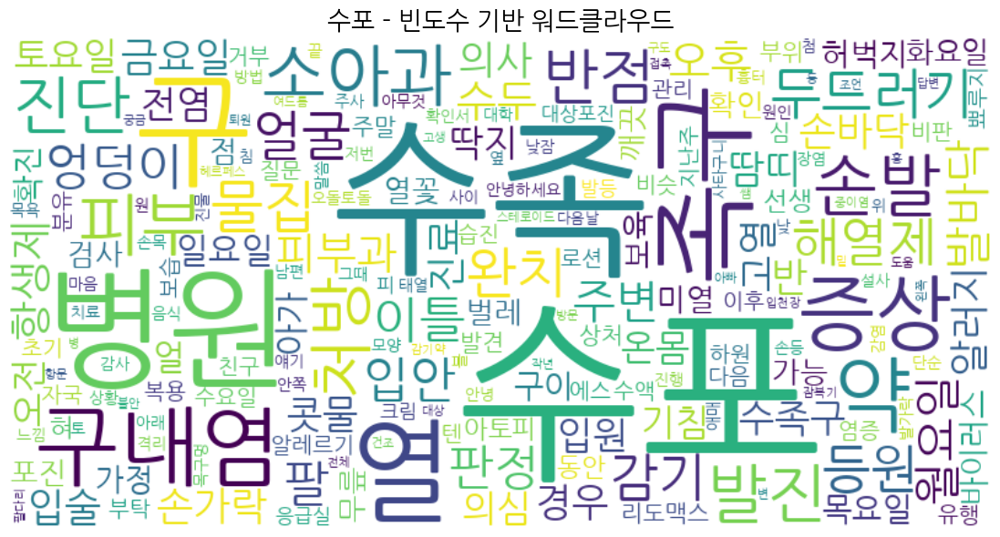

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


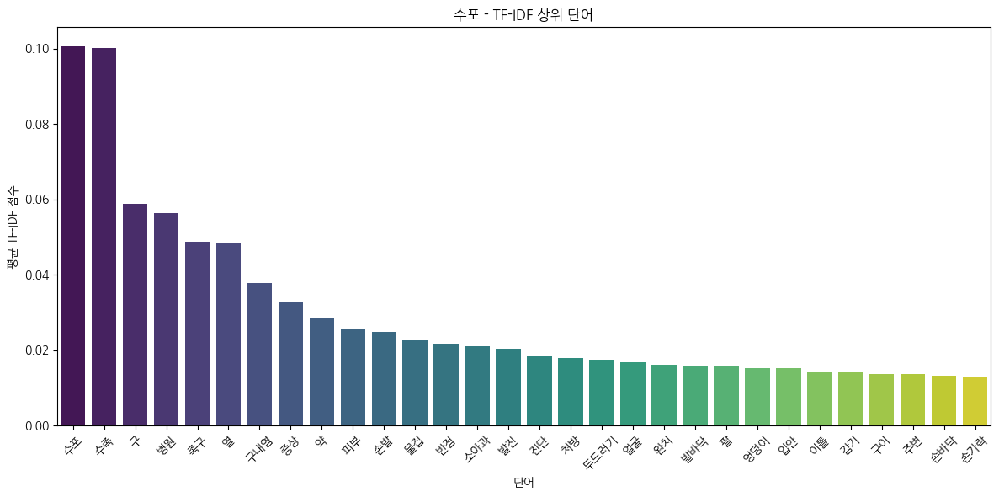

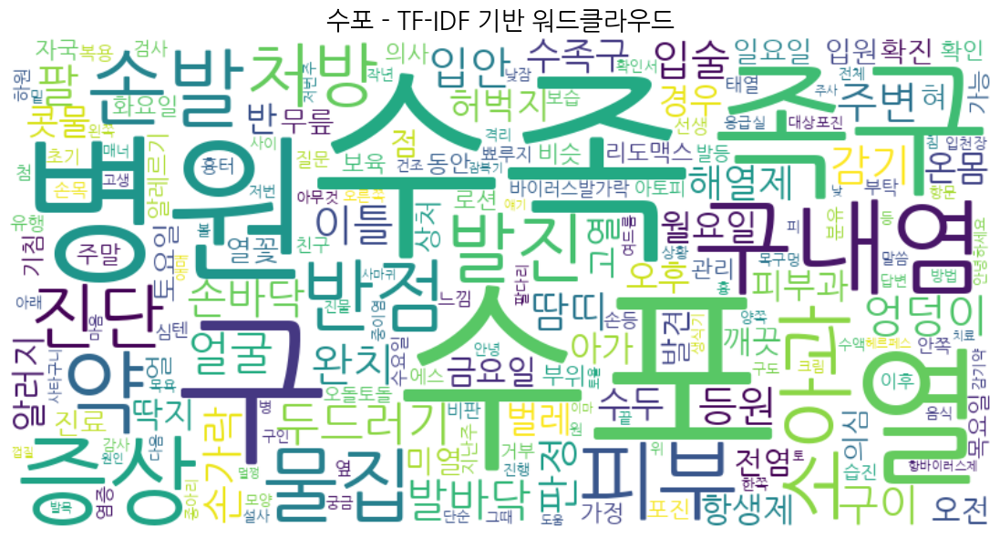


===== otitis 키워드 데이터 분석 =====
otitis 키워드 포함 문서 수: 1382


<ipython-input-34-2327dd78dac5>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='빈도수', data=df_top_tokens, palette='viridis')


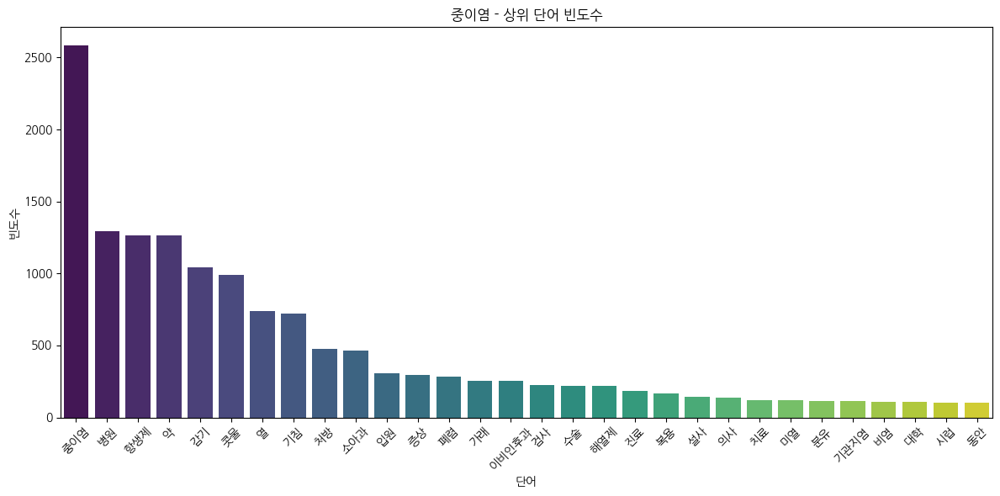

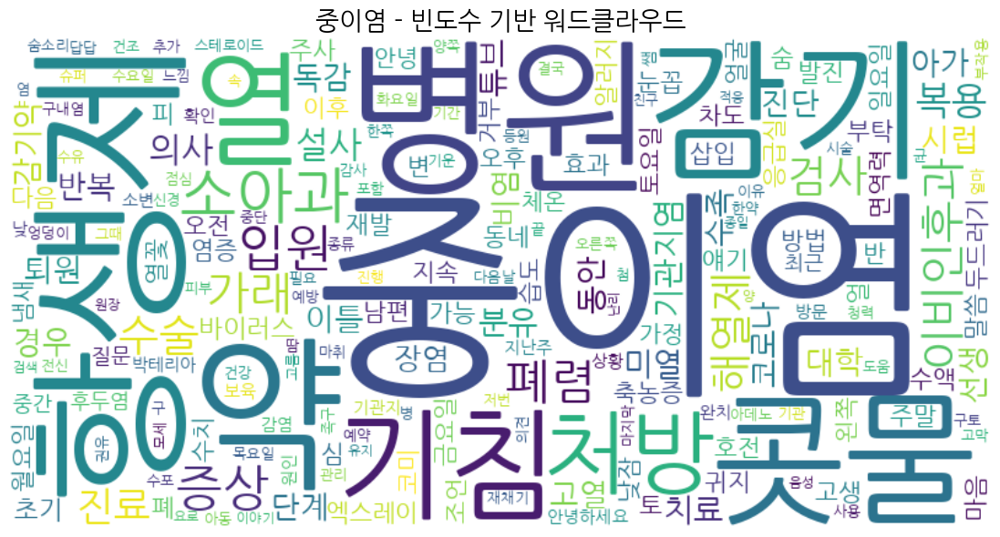

<ipython-input-34-2327dd78dac5>:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='단어', y='TF-IDF', data=df_top_tfidf, palette='viridis')


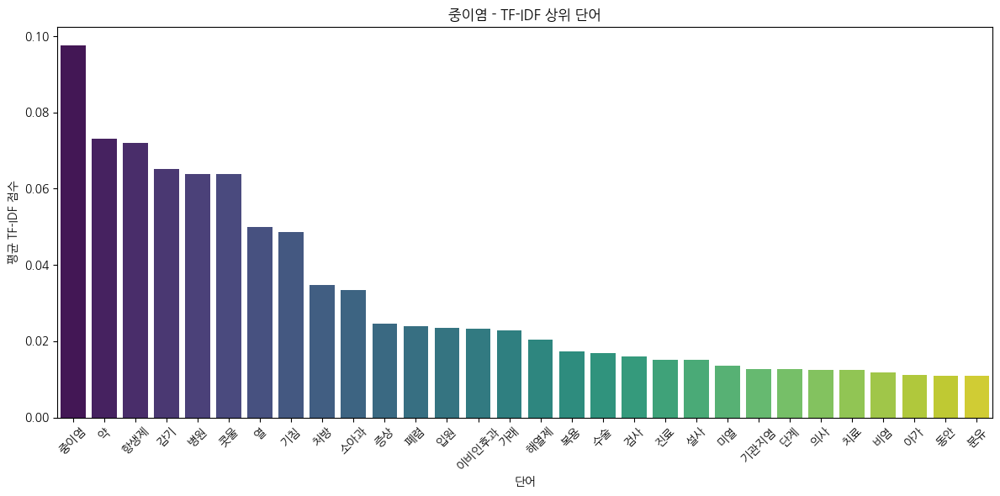

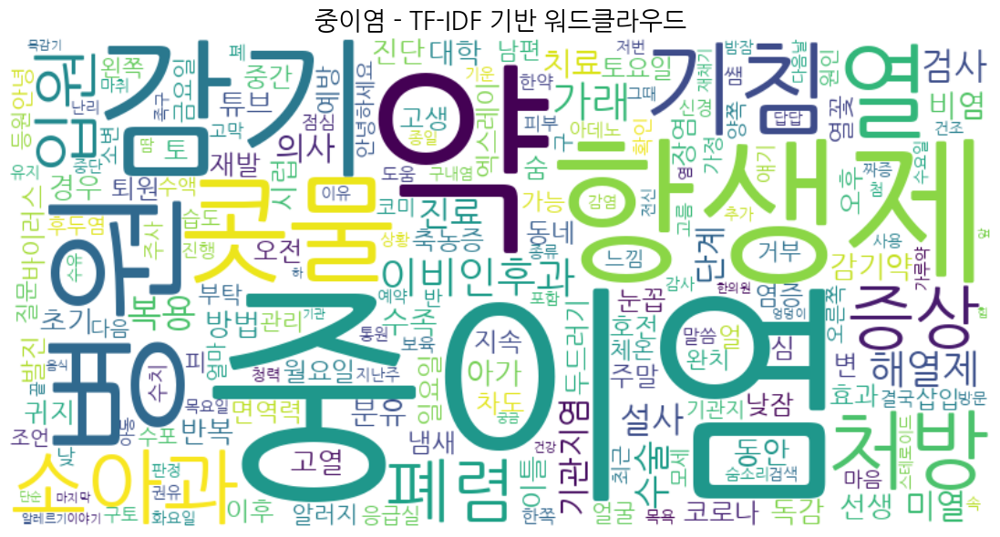

In [38]:
# 그룹별 분석
for group_name, keywords in keyword_groups.items():
    print(f"\n===== {group_name} 키워드 데이터 분석 =====")
    group_df = df[df[f'has_{group_name}']]
    print(f"{group_name} 키워드 포함 문서 수: {len(group_df)}")

    if len(group_df) > 0:
        # 화면에 표시할 그룹 이름
        display_name = display_name_mapping.get(group_name, group_name)

        # 분석 및 시각화 실행
        group_token_freq, group_tfidf_dict = analyze_and_visualize(
            group_df, display_name, True, output_dir
        )

        group_results[group_name] = {
            'df': group_df,
            'token_freq': group_token_freq,
            'tfidf_dict': group_tfidf_dict
        }


In [39]:
# 그룹 간 비교 분석
def compare_groups_visualization(group_dicts, group_names, title, top_n=20, save_plot=False, output_file=None):
    """
    여러 그룹의 데이터를 비교하여 시각화하는 함수

    Parameters:
    - group_dicts: 그룹별 데이터 사전 (단어 빈도수 또는 TF-IDF)
    - group_names: 그룹 이름 목록
    - title: 시각화 제목
    - top_n: 상위 몇 개의 단어를 표시할지 결정
    - save_plot: 그래프를 저장할지 여부
    - output_file: 저장할 파일 경로
    """
    # 빈 딕셔너리가 있는지 확인
    valid_groups = [(name, dict_) for name, dict_ in zip(group_names, group_dicts) if dict_]
    if not valid_groups:
        print(f"비교할 그룹 데이터가 없습니다.")
        return

    group_names = [name for name, _ in valid_groups]
    group_dicts = [dict_ for _, dict_ in valid_groups]

    # 모든 그룹에서 상위 단어 추출
    all_top_words = set()
    for group_dict in group_dicts:
        top_words = sorted(group_dict.items(), key=lambda x: x[1], reverse=True)[:top_n]
        all_top_words.update([word for word, _ in top_words])

    # 비교 데이터프레임 생성
    comparison_data = []
    for word in all_top_words:
        row = {'단어': word}
        for i, group_dict in enumerate(group_dicts):
            row[group_names[i]] = group_dict.get(word, 0)
        comparison_data.append(row)

    df_comparison = pd.DataFrame(comparison_data)

    # 첫 번째 그룹 기준으로 정렬
    if group_names:
        df_comparison = df_comparison.sort_values(by=group_names[0], ascending=False).head(top_n)

    # 시각화
    plt.figure(figsize=(14, 10))
    df_comparison_melted = df_comparison.melt(id_vars=['단어'], var_name='그룹', value_name='값')
    sns.barplot(x='단어', y='값', hue='그룹', data=df_comparison_melted)
    plt.title(f'그룹별 {title} 비교')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.legend(title='그룹')

    if save_plot and output_file:
        plt.savefig(output_file, dpi=300)

    plt.show()

In [40]:
# 주요 그룹 선택 (상위 8개 그룹)
top_groups = sorted(group_counts.items(), key=lambda x: x[1][0], reverse=True)[:8]
top_group_names = [group_name for group_name, _ in top_groups]


===== 주요 그룹별 빈도수 비교 =====


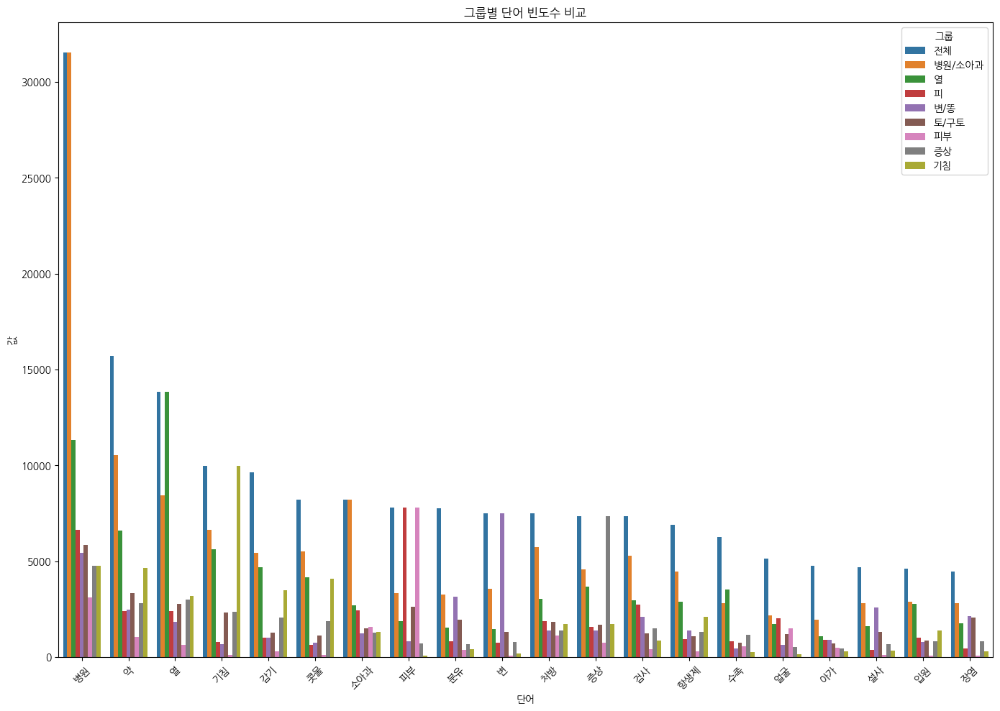

In [41]:
# 주요 그룹별 빈도수 비교
print("\n===== 주요 그룹별 빈도수 비교 =====")
top_group_freq_dicts = [all_token_freq] + [group_results[group_name]['token_freq'] for group_name in top_group_names if group_name in group_results]
top_group_display_names = ['전체'] + [display_name_mapping.get(group_name, group_name) for group_name in top_group_names if group_name in group_results]

if len(top_group_freq_dicts) > 1:
    compare_groups_visualization(
        top_group_freq_dicts,
        top_group_display_names,
        '단어 빈도수',
        save_plot=True,
        output_file=os.path.join(output_dir, 'top_groups_frequency_comparison.png')
    )


===== 주요 그룹별 TF-IDF 비교 =====


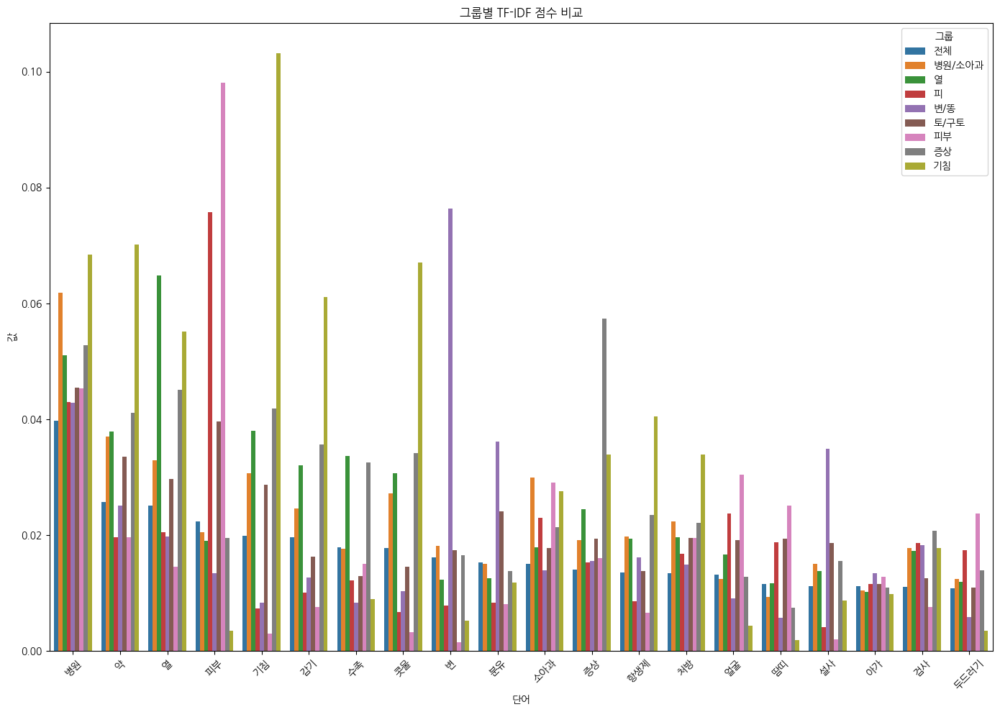

In [42]:
# 주요 그룹별 TF-IDF 비교
print("\n===== 주요 그룹별 TF-IDF 비교 =====")
top_group_tfidf_dicts = [all_tfidf_dict] + [group_results[group_name]['tfidf_dict'] for group_name in top_group_names if group_name in group_results]

if len(top_group_tfidf_dicts) > 1 and all(bool(d) for d in top_group_tfidf_dicts):
    compare_groups_visualization(
        top_group_tfidf_dicts,
        top_group_display_names,
        'TF-IDF 점수',
        save_plot=True,
        output_file=os.path.join(output_dir, 'top_groups_tfidf_comparison.png')
    )

In [43]:
# 그룹 간 중복 분석
print("\n===== 그룹 간 중복 분석 =====")
# 중복 행렬 생성
overlap_matrix = np.zeros((len(keyword_groups), len(keyword_groups)))
group_names = list(keyword_groups.keys())

for i, group1 in enumerate(group_names):
    for j, group2 in enumerate(group_names):
        # 두 그룹 모두에 포함된 문서 수
        overlap_count = df[df[f'has_{group1}'] & df[f'has_{group2}']].shape[0]
        # 중복 비율 계산 (그룹1에 대한 비율)
        if df[f'has_{group1}'].sum() > 0:
            overlap_ratio = overlap_count / df[f'has_{group1}'].sum()
            overlap_matrix[i, j] = overlap_ratio * 100  # 퍼센트로 변환


===== 그룹 간 중복 분석 =====


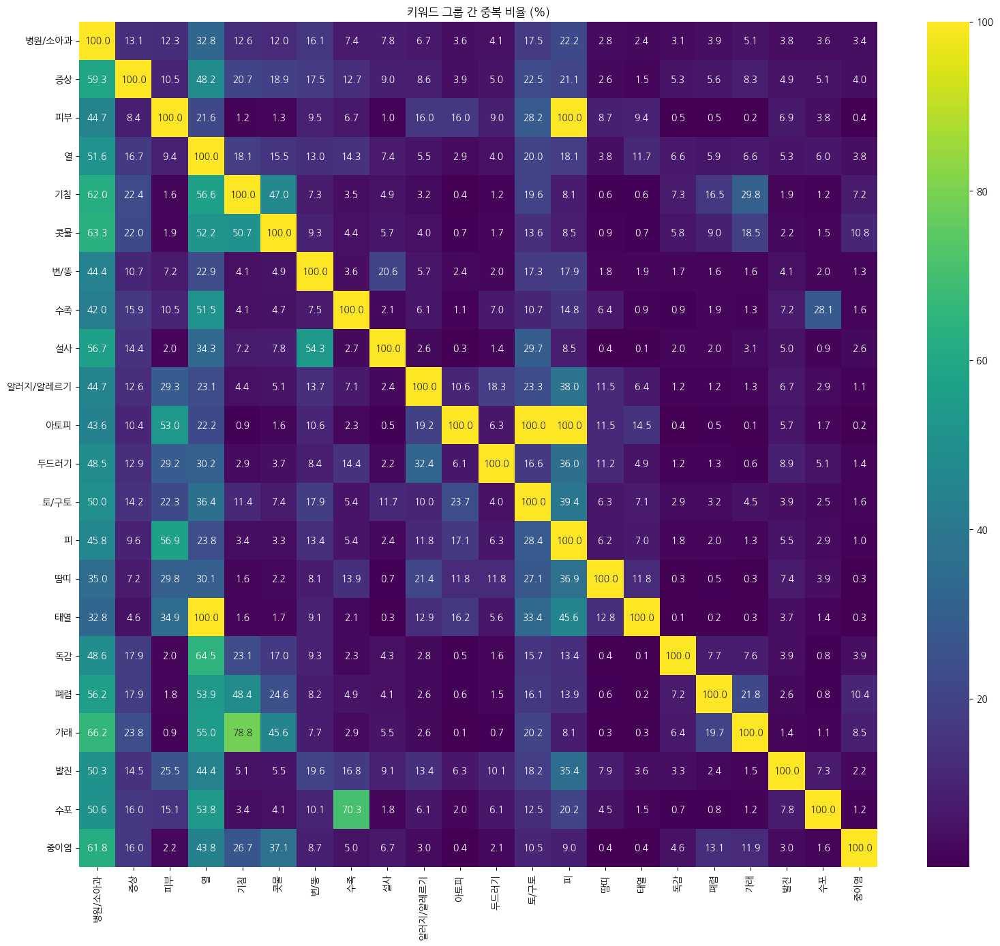

In [44]:
# 히트맵 시각화
plt.figure(figsize=(16, 14))
display_group_names = [display_name_mapping.get(name, name) for name in group_names]
sns.heatmap(
    overlap_matrix,
    annot=True,
    fmt='.1f',
    xticklabels=display_group_names,
    yticklabels=display_group_names,
    cmap='viridis'
)
plt.title('키워드 그룹 간 중복 비율 (%)')
plt.tight_layout()
plt.savefig(os.path.join(output_dir, 'group_overlap_heatmap.png'), dpi=300)
plt.show()

In [45]:
# 결과 요약
print("\n===== 분석 결과 요약 =====")
print(f"전체 문서 수: {len(df)}")
print(f"키워드 그룹별 문서 수:")
for group_name in group_names:
    count = df[f'has_{group_name}'].sum()
    percentage = (count / len(df)) * 100
    display_name = display_name_mapping.get(group_name, group_name)
    print(f"- {display_name}: {count}개 ({percentage:.1f}%)")

print(f"\n분석 결과는 '{output_dir}' 디렉토리에 저장되었습니다.")


===== 분석 결과 요약 =====
전체 문서 수: 65600
키워드 그룹별 문서 수:
- 병원/소아과: 25211개 (38.4%)
- 증상: 5559개 (8.5%)
- 피부: 6952개 (10.6%)
- 열: 16039개 (24.4%)
- 기침: 5130개 (7.8%)
- 콧물: 4762개 (7.3%)
- 변/똥: 9134개 (13.9%)
- 수족: 4440개 (6.8%)
- 설사: 3472개 (5.3%)
- 알러지/알레르기: 3793개 (5.8%)
- 아토피: 2091개 (3.2%)
- 두드러기: 2146개 (3.3%)
- 토/구토: 8805개 (13.4%)
- 피: 12224개 (18.6%)
- 땀띠: 2039개 (3.1%)
- 태열: 1880개 (2.9%)
- 독감: 1631개 (2.5%)
- 폐렴: 1747개 (2.7%)
- 가래: 1938개 (3.0%)
- 발진: 1897개 (2.9%)
- 수포: 1774개 (2.7%)
- 중이염: 1382개 (2.1%)

분석 결과는 '/content/drive/MyDrive/babycareai/analysis_results' 디렉토리에 저장되었습니다.
